# Introduction to Deep Learning

<div style="text-align: right">   </div>


Introduction to Deep Learning (2024) &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;| &nbsp;
-------|-------------------
**Assignment 1, Part 3: Generative Models** | <img src="https://upload.wikimedia.org/wikipedia/commons/thumb/b/b0/UniversiteitLeidenLogo.svg/1280px-UniversiteitLeidenLogo.svg.png" width="300">


In this notebook we are going to cover two generative models for generating novel images:

1. Variational Autoencoders (**VAEs**)
2. Generative adversarial networks (**GANs**)


<img src="https://lilianweng.github.io/lil-log/assets/images/three-generative-models.png" width="500">


Your main goal will be to retrain these models on a dataset of your choice and do some experiments on the learned latent space.

You should first copy this notebook and enable GPU runtime in 'Runtime -> Change runtime type -> Hardware acceleration -> GPU **OR** TPU'.


In [ ]:
### If you are running on LIACS Lab machines, run the command below to reproduce the same package environment as Colab

# !pip install tf_keras==2.17.0 # Uncomment this to set up the right version

In [1]:
import os
os.environ['TF_USE_LEGACY_KERAS'] = '1'

from tqdm import tqdm
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive', force_remount=True)
os.chdir('/content/drive/My Drive')

Mounted at /content/drive


In [8]:
!wget https://surfdrive.surf.nl/files/index.php/s/62Lnr1AtGe9b0v9/download -O face_dataset_64x64.npy

--2024-12-12 08:59:32--  https://surfdrive.surf.nl/files/index.php/s/62Lnr1AtGe9b0v9/download
Resolving surfdrive.surf.nl (surfdrive.surf.nl)... 145.107.56.140, 145.100.27.67, 145.107.8.140, ...
Connecting to surfdrive.surf.nl (surfdrive.surf.nl)|145.107.56.140|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 503083136 (480M) [application/octet-stream]
Saving to: ‘face_dataset_64x64.npy’

face_dataset_64x64. 100%[===================>] 479.78M  24.8MB/s    in 26s     

2024-12-12 08:59:58 (18.8 MB/s) - ‘face_dataset_64x64.npy’ saved [503083136/503083136]




### Dataset

This dataset is called [Flickr-Faces-HQ Dataset](https://github.com/NVlabs/ffhq-dataset). Here we will use a downsampled version of it (64x64x3) that will speed up all the experiments. [Download](https://surfdrive.surf.nl/files/index.php/s/LXBrnGGvUISlckW).

After downloading you should copy it to your google drive's main directory (or modify the code to load it from elsewhere).

After running the notebook on this default dataset you then need to find a dataset of your own.

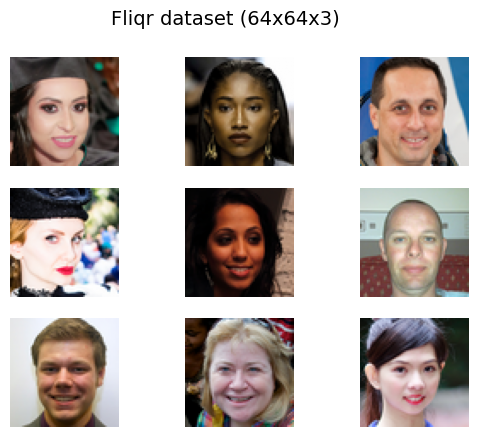

In [2]:
def load_real_samples(data_path, scale=False):
    # We load 20,000 samples only to avoid memory issues, you can  change this value
    X = np.load(data_path, fix_imports=True, encoding='latin1')[:20000, :, :, :]
    # Scale samples in range [-127, 127]
    if scale:
        X = (X - 127.5) * 2
    return X / 255.

# We will use this function to display the output of our models throughout this notebook
def grid_plot(images, epoch='', name='', n=3, save=False, scale=False):
    if scale:
        images = (images + 1) / 2.0
    for index in range(n * n):
        plt.subplot(n, n, 1 + index)
        plt.axis('off')
        plt.imshow(images[index])
    fig = plt.gcf()
    fig.suptitle(name + '  '+ str(epoch), fontsize=14)
    if save:
        filename = 'results/generated_plot_e%03d_f.png' % (epoch+1)
        plt.savefig(filename)
        plt.close()
    plt.show()

data_path = '/content/drive/My Drive/face_dataset_64x64.npy'

dataset = load_real_samples(data_path)
grid_plot(dataset[np.random.randint(0, 1000, 9)], name='Fliqr dataset (64x64x3)', n=3)

## 2.1. Introduction

The generative models that we are going to cover both have the following components:

1. A downsampling architecture (encoder in case of VAE, and discriminator in case of GAN) to either extract features from the data or model its distribution.
2. An upsampling architecture (decoder for VAE, generator for GAN) that will use some kind of latent vector to generate new samples that resemble the data that it was trained on.

Since we are going to be dealing with images, we are going to use convolutional networks for upsampling and downsampling, similar to what you see below.

<img src="https://i2.wp.com/sefiks.com/wp-content/uploads/2018/03/convolutional-autoencoder.png" width="500">


#### Code for building these components:

In [3]:
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Conv2DTranspose, Reshape

def build_conv_net(in_shape, out_shape, n_downsampling_layers=4, filters=128, hierarch_filters=False, out_activation='sigmoid'):
    """
    Build a basic convolutional network
    """
    default_args=dict(kernel_size=(3,3), strides=(2,2), padding='same', activation='relu')

    input = tf.keras.Input(shape=in_shape)
    x = Conv2D(filters=filters, name='enc_input', **default_args)(input)

    for _ in range(n_downsampling_layers):
        if hierarch_filters:
            x = Conv2D(**default_args, filters=filters*2**_)(x)
        else:
            x = Conv2D(**default_args, filters=filters)(x)

    x = Flatten()(x)
    x = Dense(out_shape, activation=out_activation, name='enc_output')(x)

    model = tf.keras.Model(inputs=input, outputs=x, name='Encoder')

    model.summary()
    return model


def build_deconv_net(latent_dim, dense_units=1024, n_upsampling_layers=4, filters=128, hierarch_filters=False, activation_out='sigmoid', gan_mode=False):
    """
    Build a deconvolutional network for decoding/upscaling latent vectors

    When building the deconvolutional architecture, usually it is best to use the same layer sizes that
    were used in the downsampling network and the Conv2DTranspose layers are used instead of Conv2D layers.
    Using identical layers and hyperparameters ensures that the dimensionality of our output matches the
    shape of our input images.
    """
    input = tf.keras.Input(shape=(latent_dim,))

    x = Dense(dense_units, input_dim=latent_dim, name='dec_input')(input)

    if hierarch_filters:
        x = Reshape((2, 2, filters*2**(n_upsampling_layers-1)))(x)
    else:
        if gan_mode:
            x = Reshape((4, 4, 64))(x)
        else:
            x = Reshape((2, 2, filters))(x)

    default_args=dict(kernel_size=(3,3), strides=(2,2), padding='same', activation='relu')

    for i in range(n_upsampling_layers):
        if hierarch_filters:
            x = Conv2DTranspose(filters=(filters*2**(n_upsampling_layers-1))/2**i, **default_args)(x)
        else:
            x = Conv2DTranspose(filters=filters, **default_args)(x)

    # This last convolutional layer converts back to 3 channel RGB image

    if gan_mode:
        x = Conv2D(filters=3, kernel_size=(3,3), padding='same', activation=activation_out, name='dec_output')(x)
    else:
        x = Conv2DTranspose(filters=3, kernel_size=(3,3), strides=(2,2), padding='same', activation=activation_out, name='dec_output')(x)

    model = tf.keras.Model(inputs=input, outputs=x, name='Decoder')
    model.summary()
    return model

### Convolutional Autoencoder example

Using these two basic building blocks we can now build a Convolutional Autoencoder (CAE).

<img src="https://lilianweng.github.io/lil-log/assets/images/autoencoder-architecture.png" width="500">



Even though it's not a generative model, CAE is a great way to illustrate how these two components (convolutional and deconvolutional networks) can be used together to reconstruct images.

You can view such model as a compression/dimensionality reduction method as each image gets compressed to a vector of 256 numbers by the encoder and gets decompressed back into an image using the decoder network.

Model: "Encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 enc_input (Conv2D)          (None, 32, 32, 128)       3584      
                                                                 
 conv2d (Conv2D)             (None, 16, 16, 128)       147584    
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 128)         147584    
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 128)         147584    
                                                                 
 conv2d_3 (Conv2D)           (None, 2, 2, 128)         147584    
                                                                 
 flatten (Flatten)           (None, 512)               0   

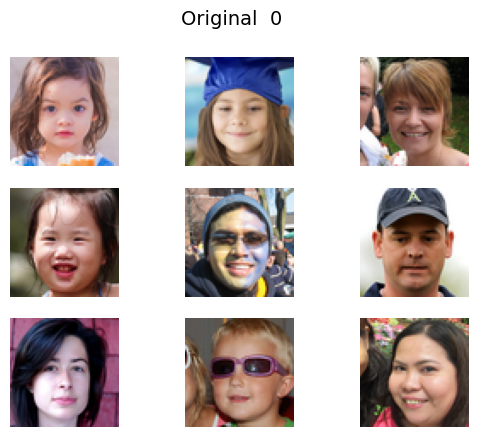

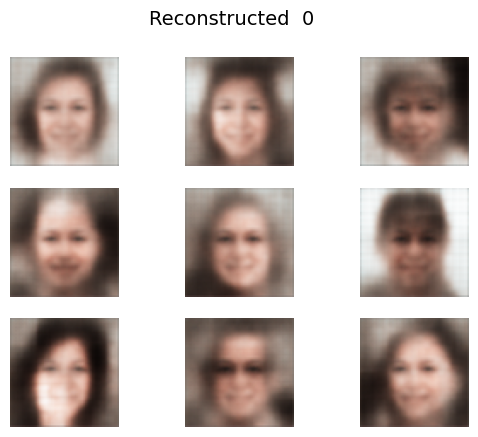


Epoch:  1
1/1 [==============================] - 0s 22ms/step


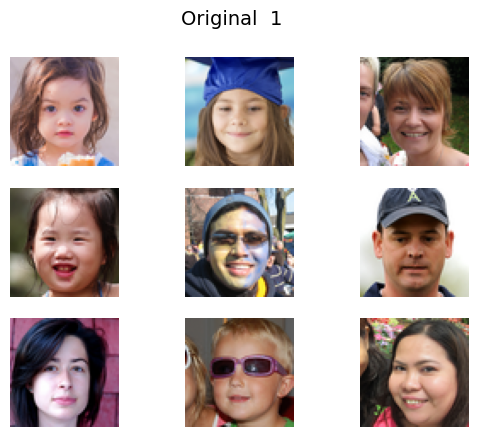

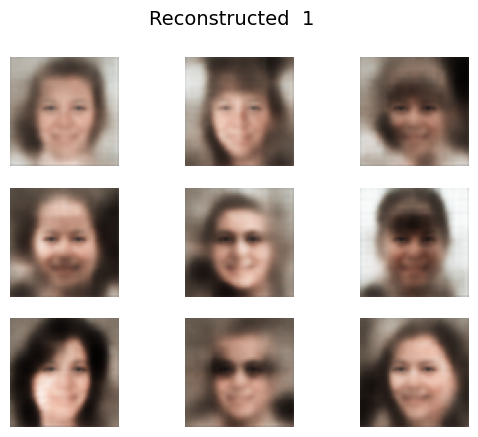


Epoch:  2
1/1 [==============================] - 0s 23ms/step


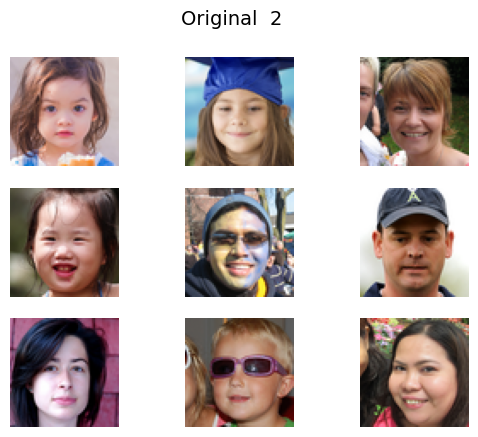

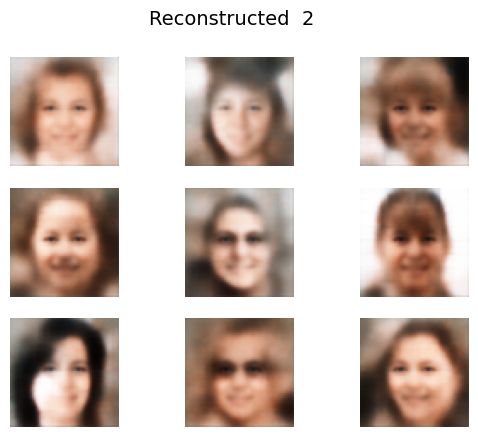


Epoch:  3
1/1 [==============================] - 0s 21ms/step


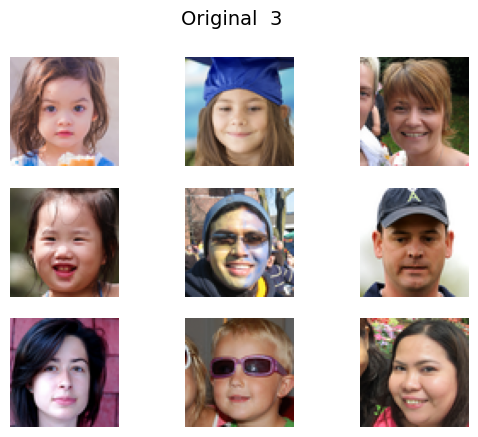

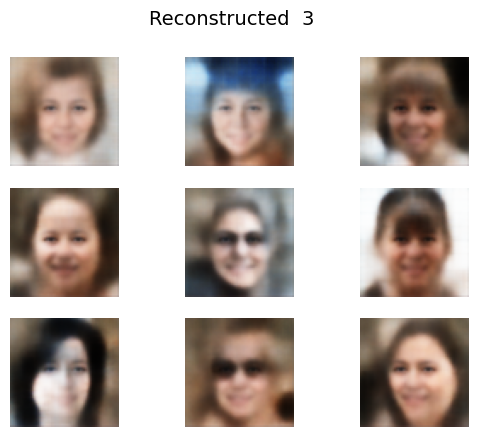


Epoch:  4
1/1 [==============================] - 0s 21ms/step


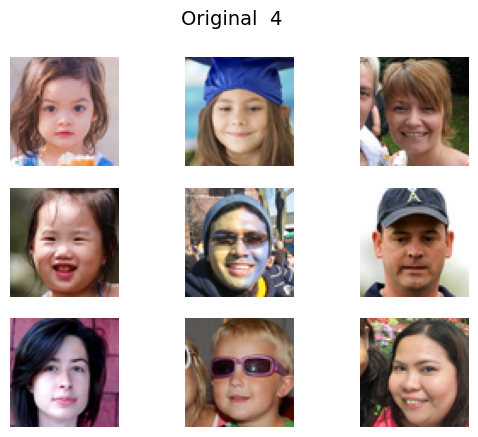

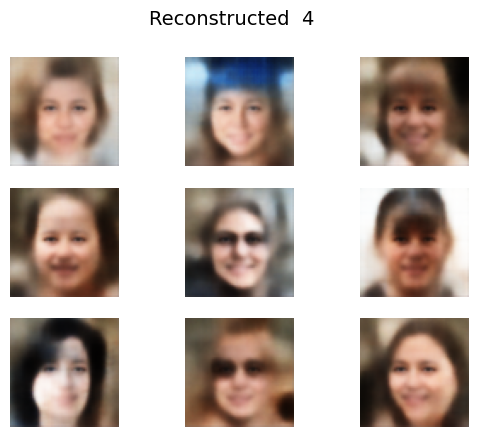


Epoch:  5
1/1 [==============================] - 0s 22ms/step


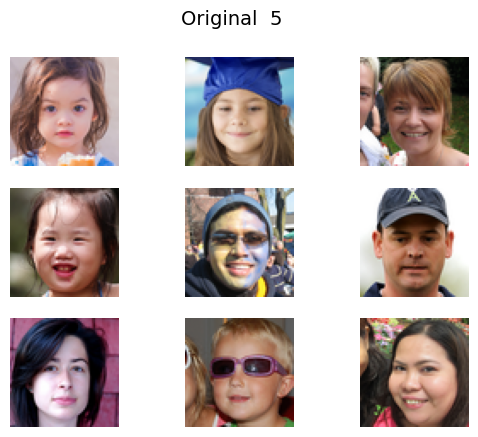

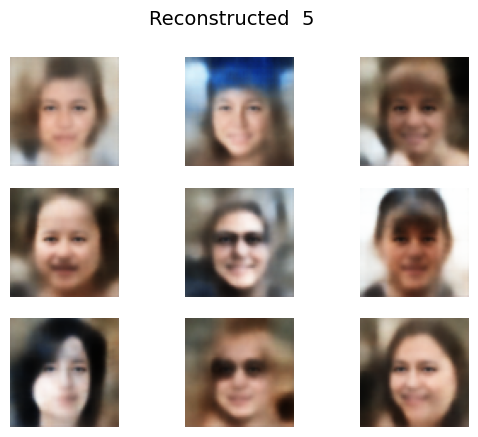


Epoch:  6
1/1 [==============================] - 0s 23ms/step


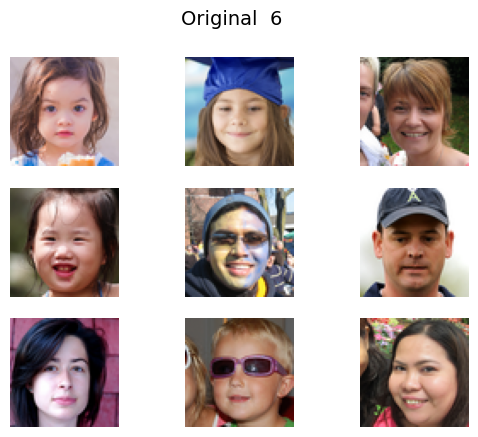

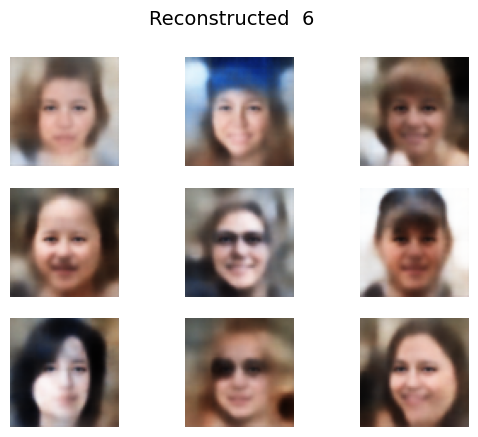


Epoch:  7
1/1 [==============================] - 0s 22ms/step


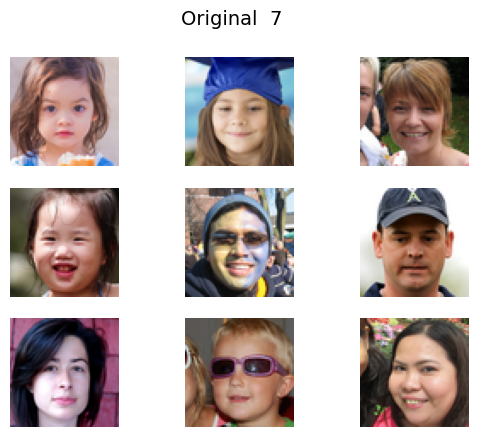

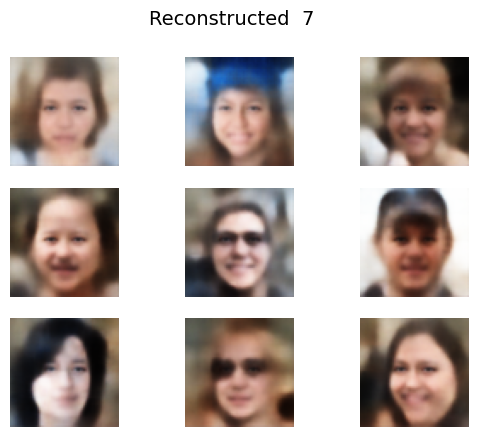


Epoch:  8
1/1 [==============================] - 0s 24ms/step


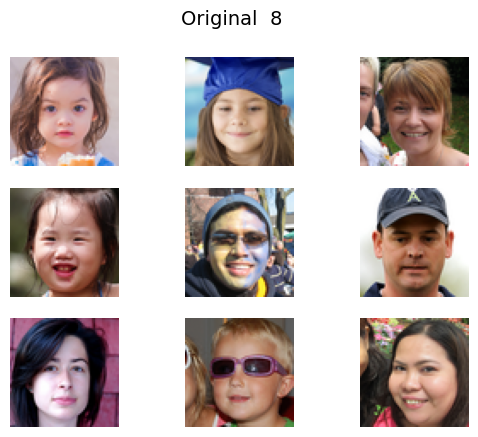

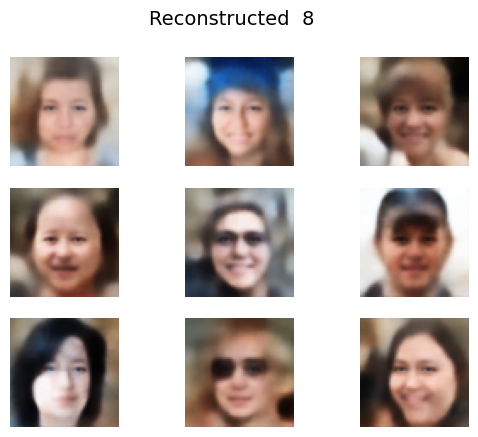


Epoch:  9
1/1 [==============================] - 0s 21ms/step


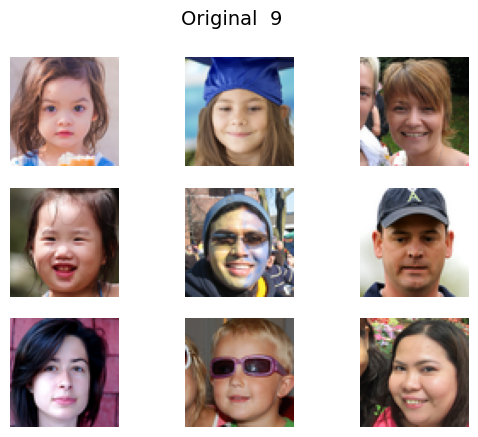

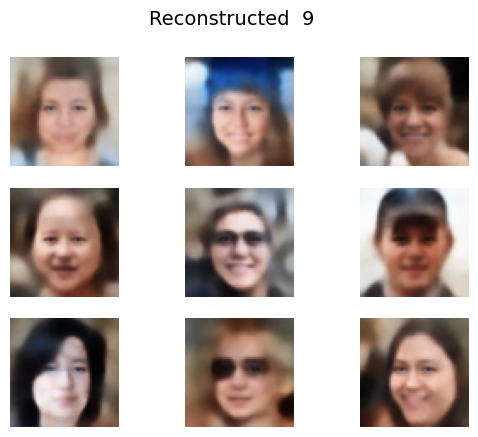


Epoch:  10
1/1 [==============================] - 0s 21ms/step


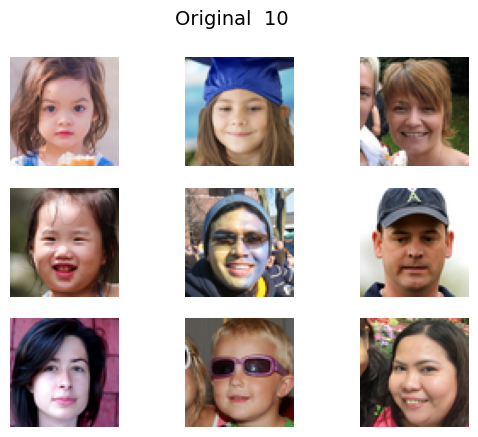

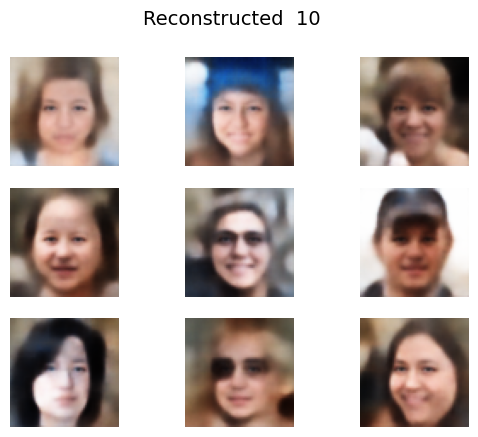


Epoch:  11
1/1 [==============================] - 0s 21ms/step


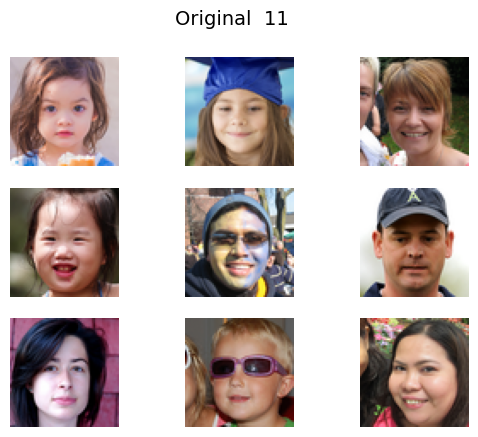

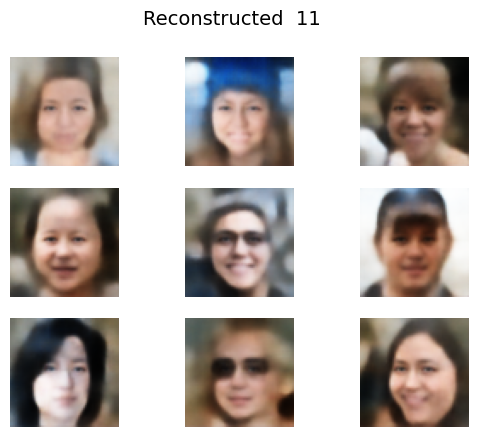


Epoch:  12
1/1 [==============================] - 0s 23ms/step


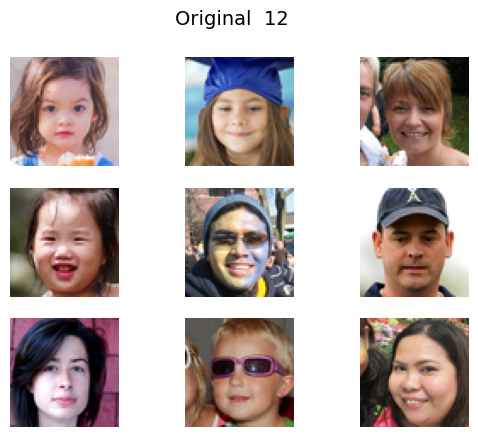

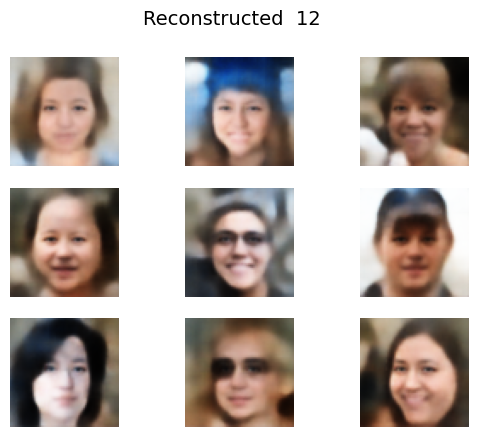


Epoch:  13
1/1 [==============================] - 0s 22ms/step


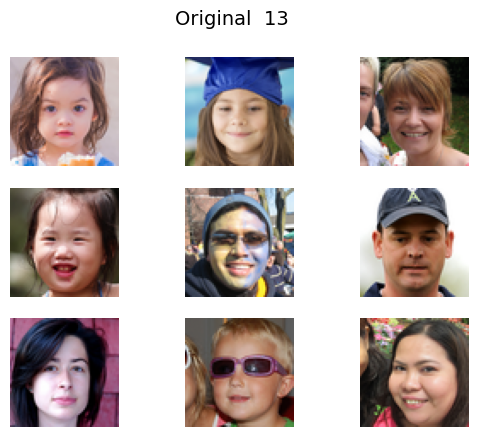

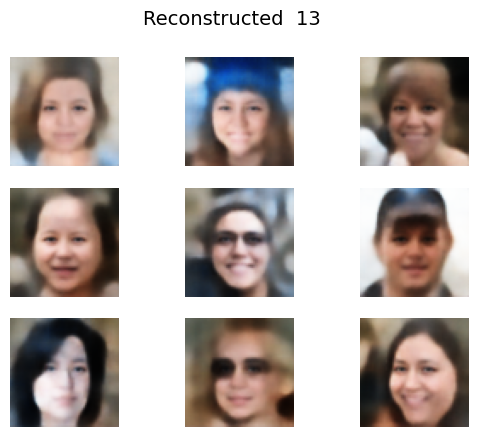


Epoch:  14
1/1 [==============================] - 0s 21ms/step


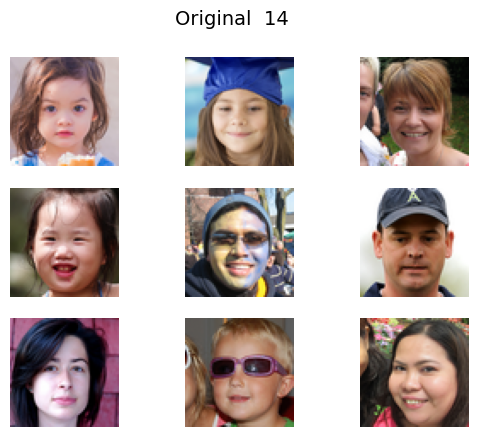

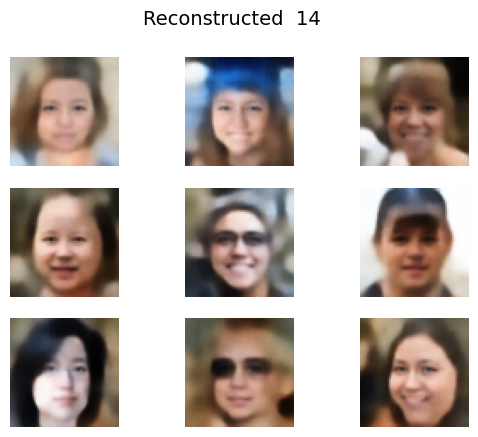


Epoch:  15
1/1 [==============================] - 0s 22ms/step


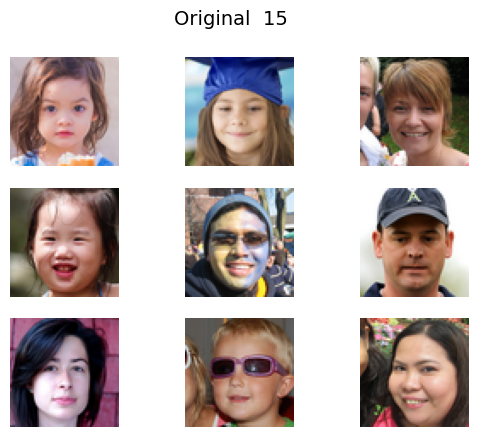

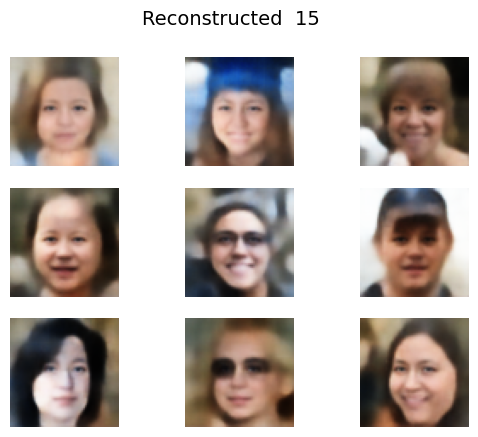


Epoch:  16
1/1 [==============================] - 0s 22ms/step


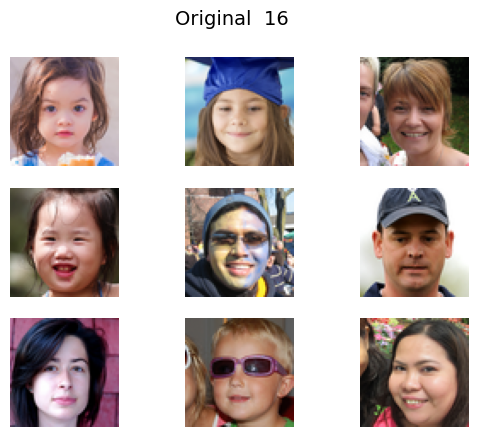

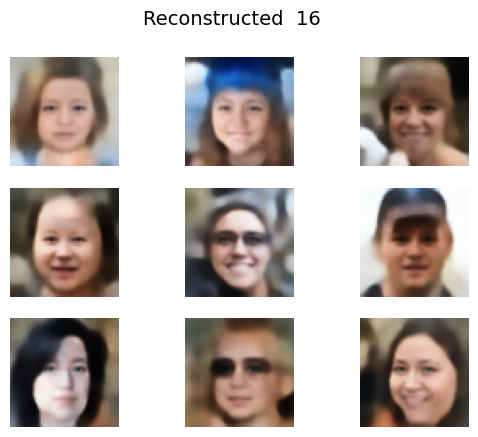


Epoch:  17
1/1 [==============================] - 0s 21ms/step


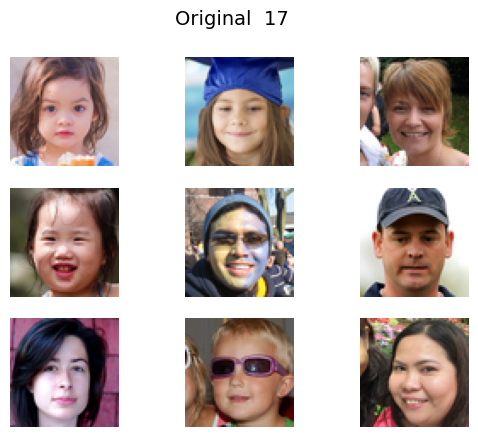

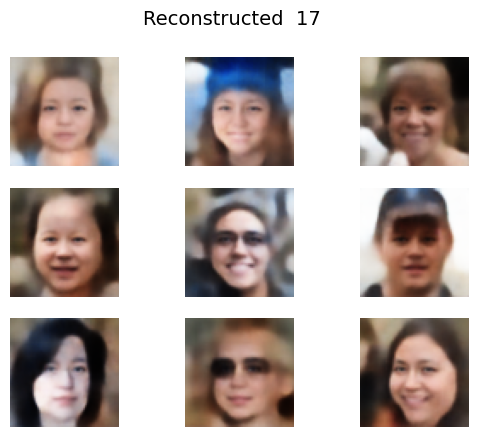


Epoch:  18
1/1 [==============================] - 0s 24ms/step


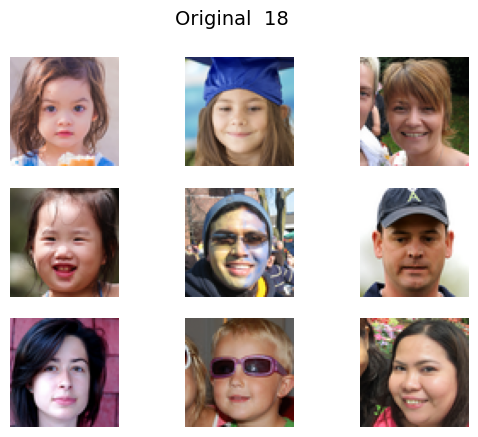

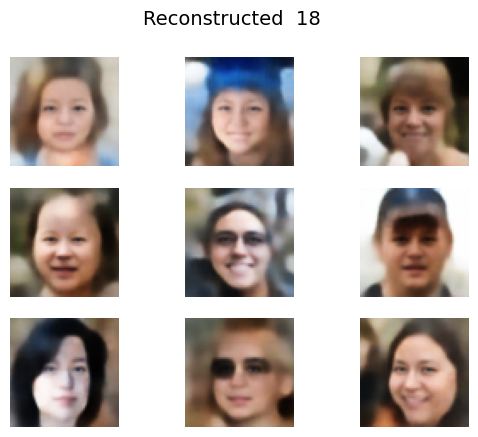


Epoch:  19
1/1 [==============================] - 0s 22ms/step


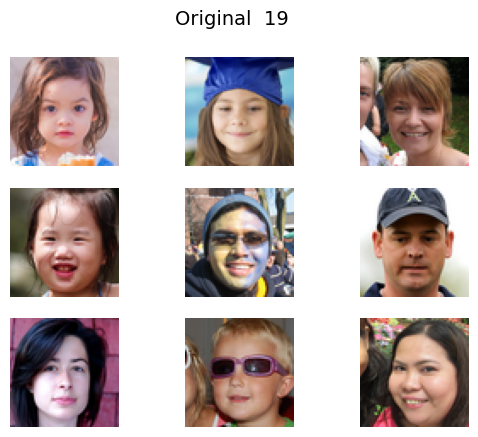

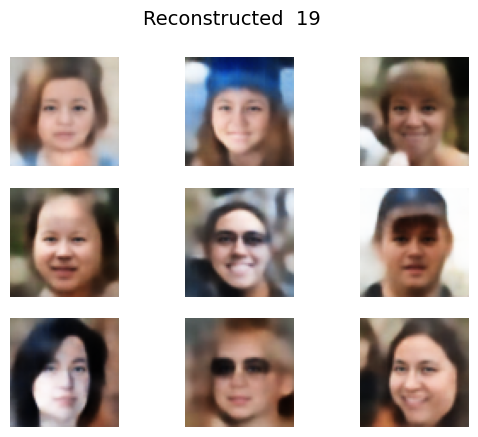


Epoch:  20
1/1 [==============================] - 0s 21ms/step


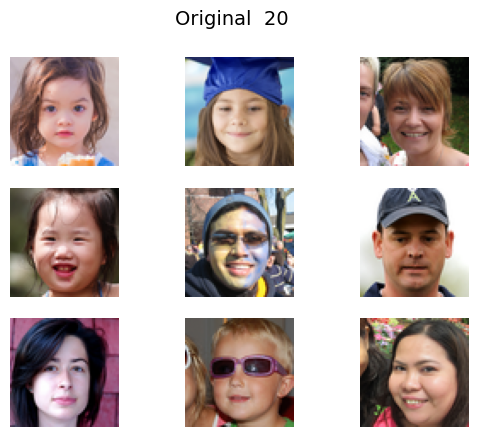

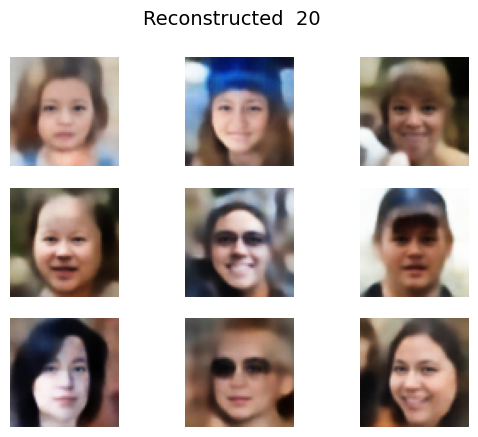


Epoch:  21
1/1 [==============================] - 0s 22ms/step


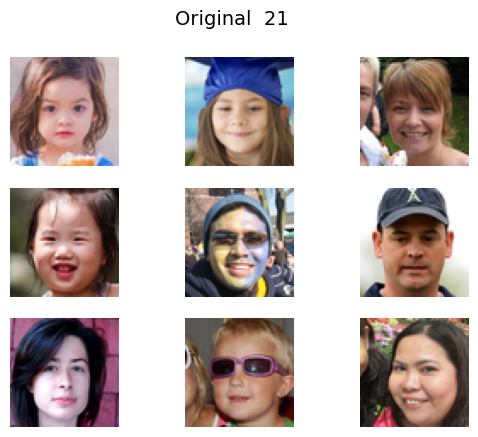

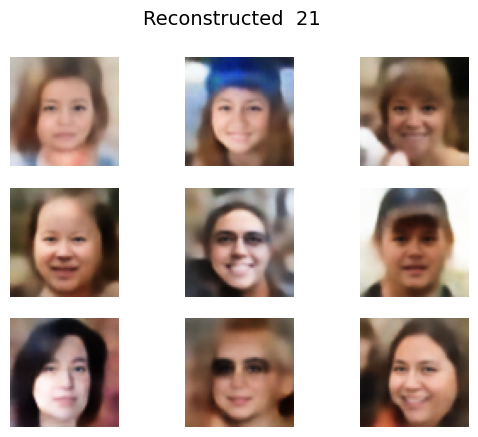


Epoch:  22
1/1 [==============================] - 0s 22ms/step


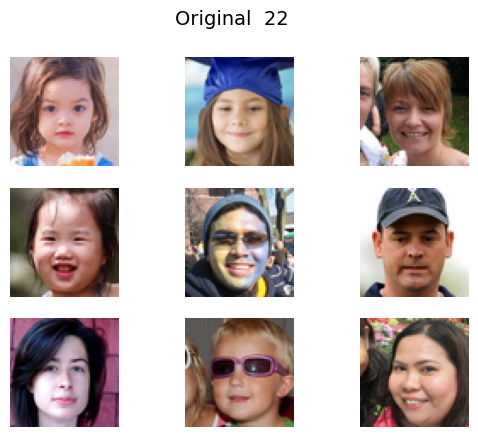

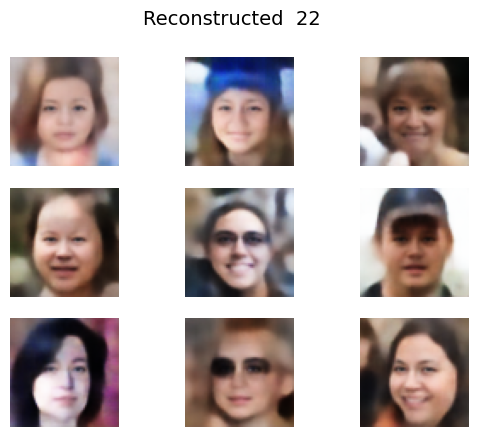


Epoch:  23
1/1 [==============================] - 0s 22ms/step


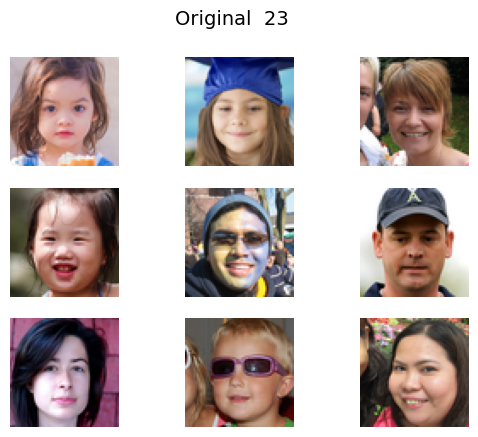

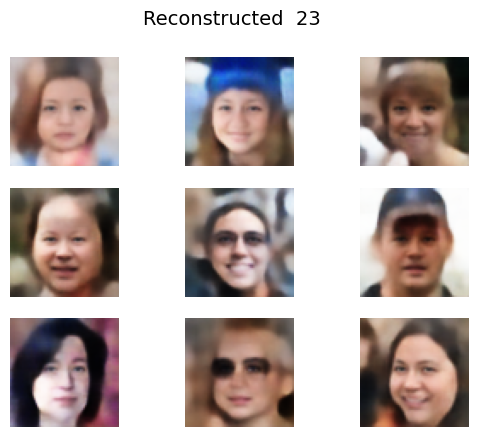


Epoch:  24
1/1 [==============================] - 0s 21ms/step


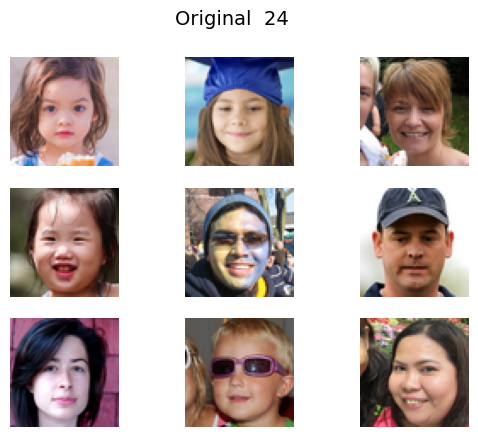

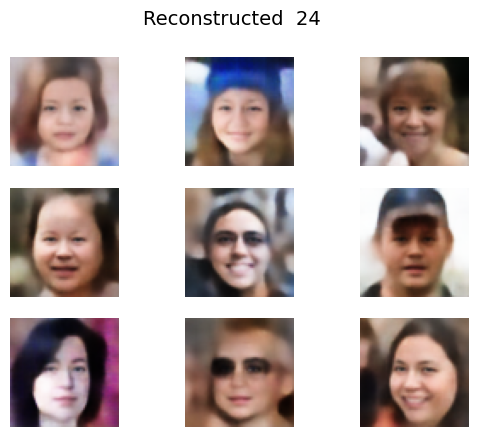


Epoch:  25
1/1 [==============================] - 0s 21ms/step


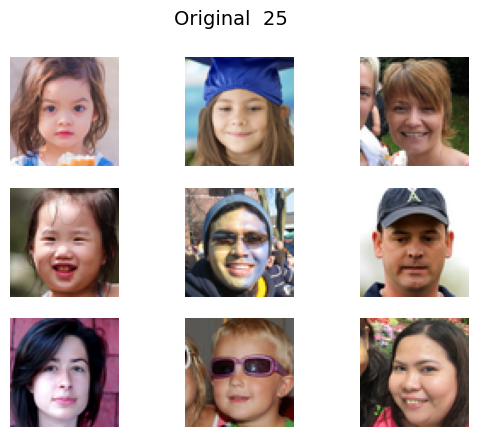

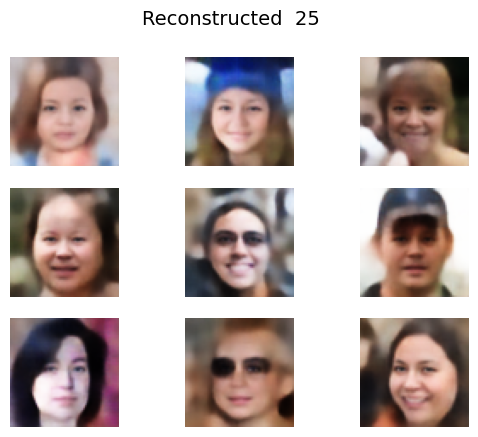


Epoch:  26
1/1 [==============================] - 0s 22ms/step


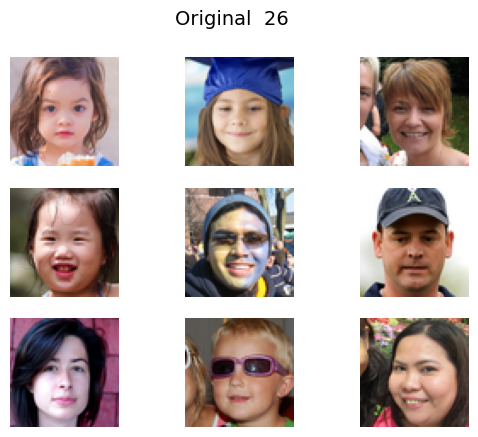

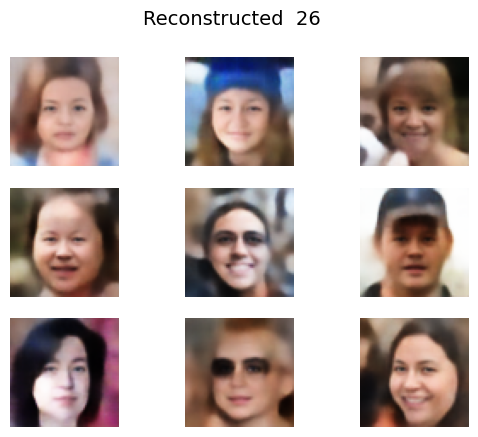


Epoch:  27
1/1 [==============================] - 0s 23ms/step


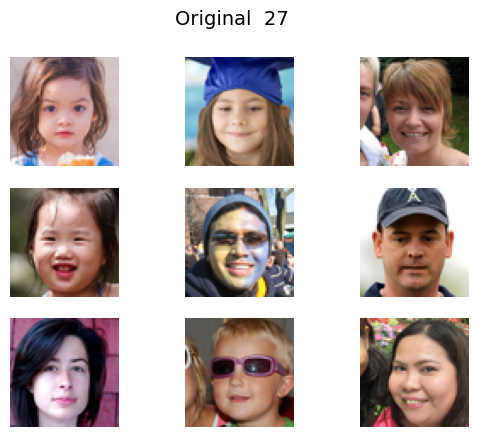

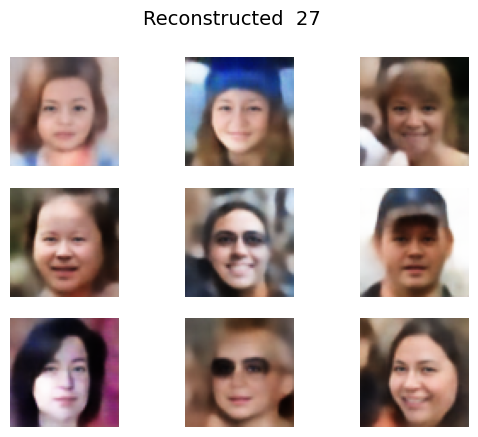


Epoch:  28
1/1 [==============================] - 0s 22ms/step


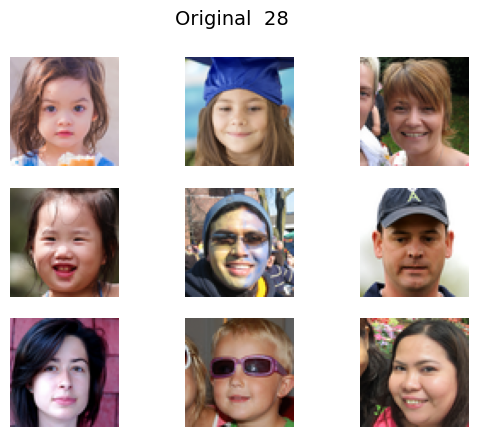

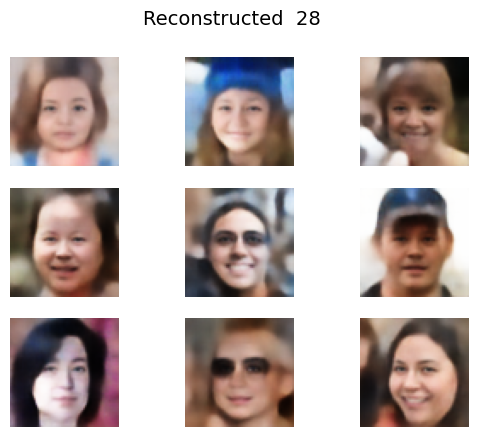


Epoch:  29
1/1 [==============================] - 0s 21ms/step


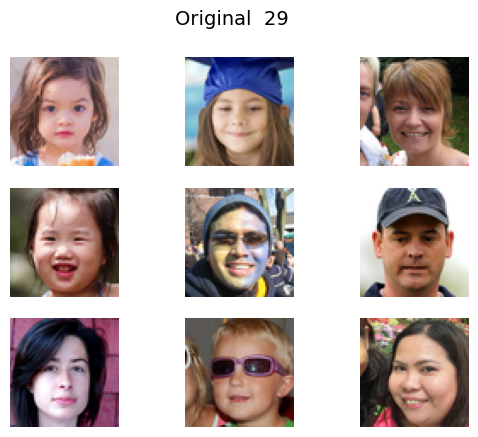

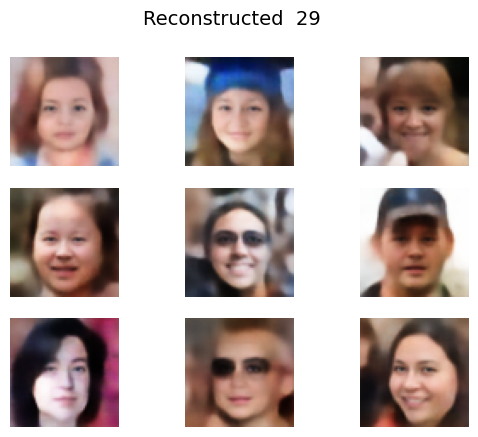


Epoch:  30
1/1 [==============================] - 0s 23ms/step


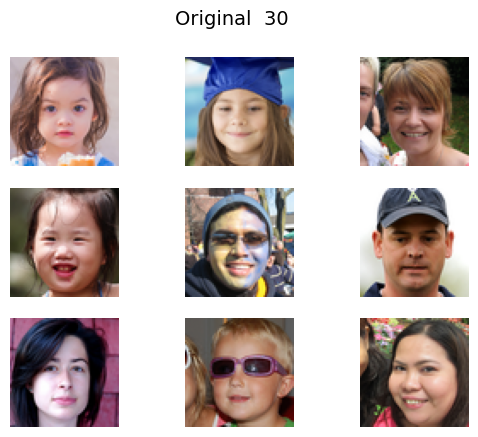

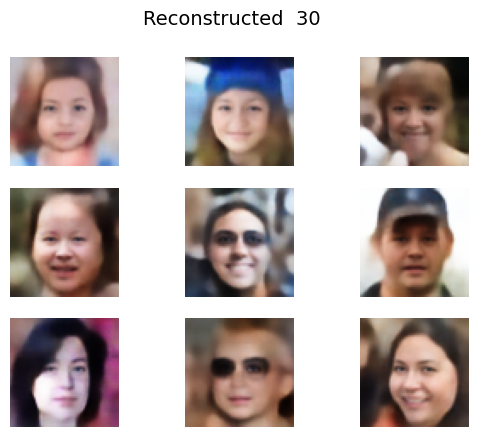


Epoch:  31
1/1 [==============================] - 0s 22ms/step


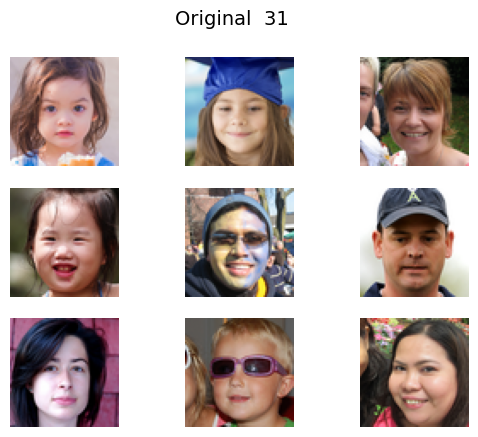

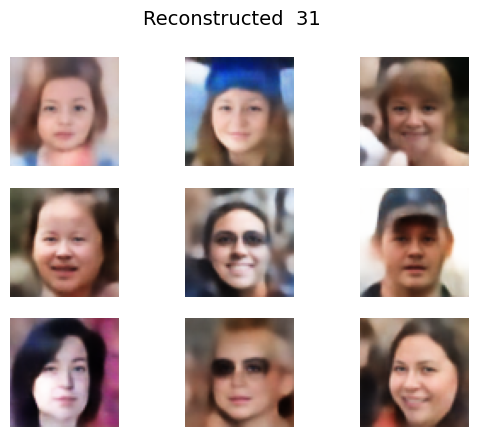


Epoch:  32
1/1 [==============================] - 0s 22ms/step


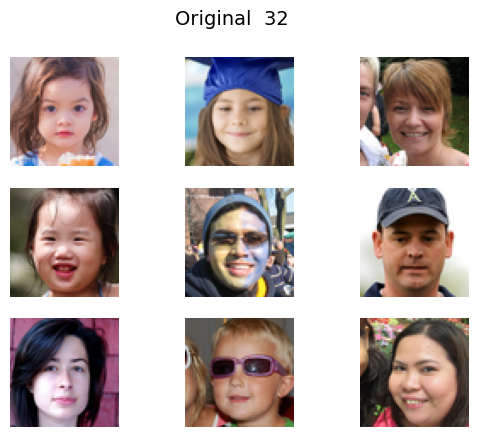

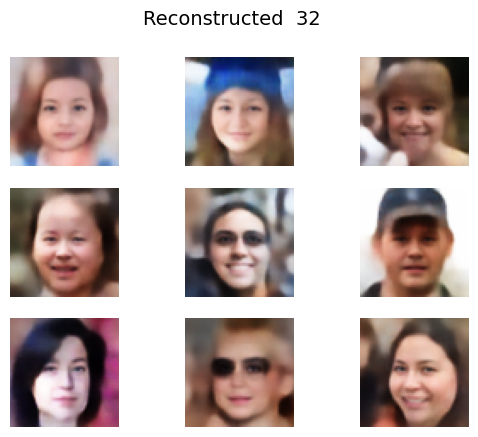


Epoch:  33
1/1 [==============================] - 0s 25ms/step


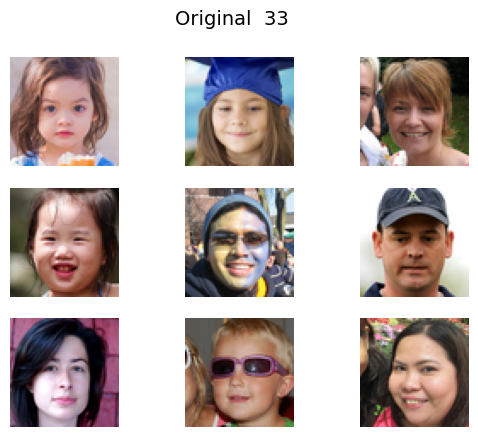

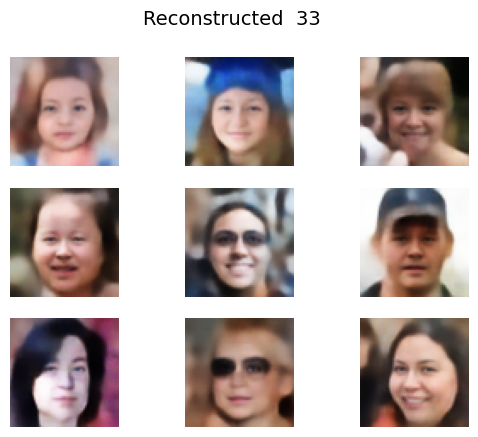


Epoch:  34
1/1 [==============================] - 0s 21ms/step


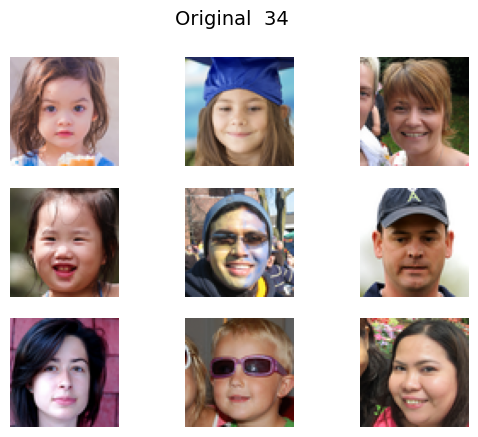

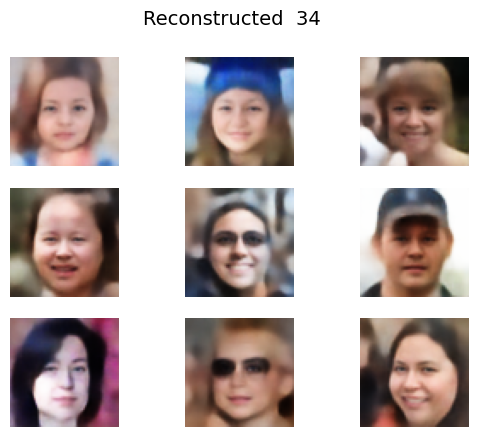


Epoch:  35
1/1 [==============================] - 0s 23ms/step


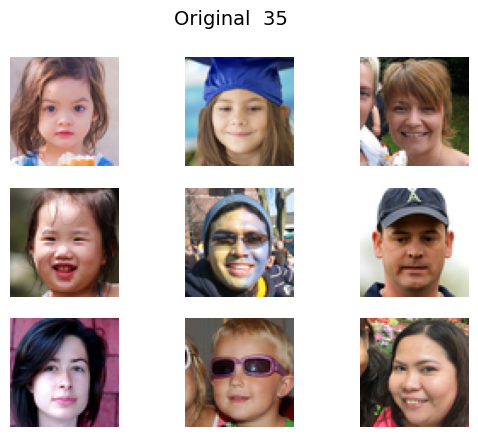

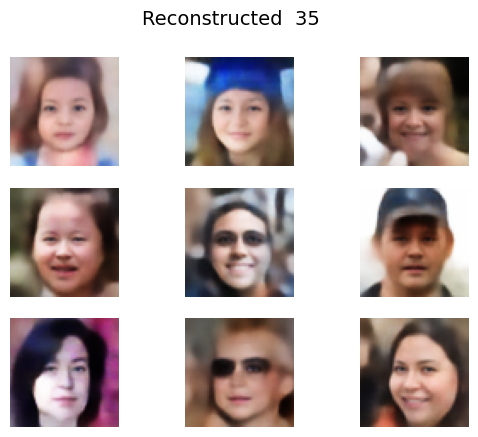


Epoch:  36
1/1 [==============================] - 0s 22ms/step


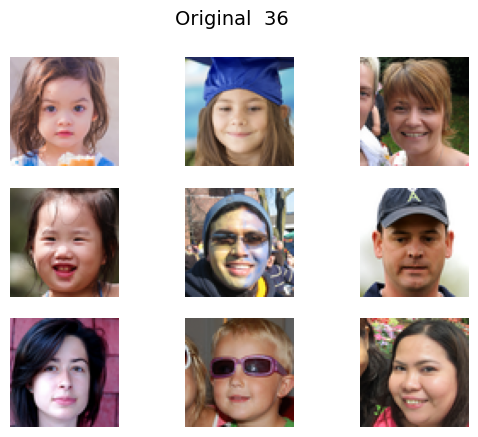

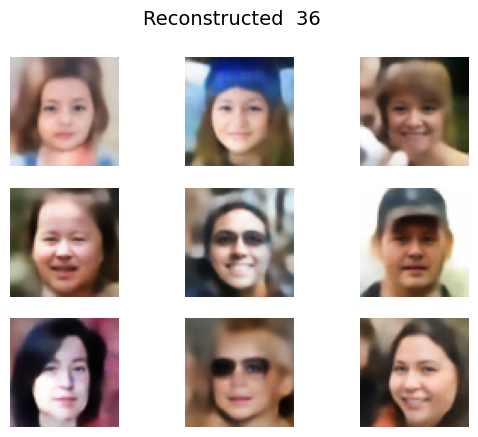


Epoch:  37
1/1 [==============================] - 0s 24ms/step


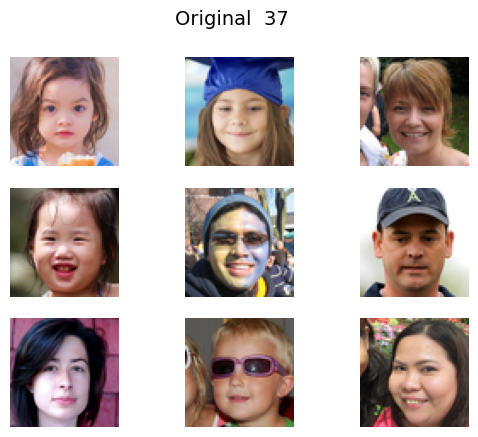

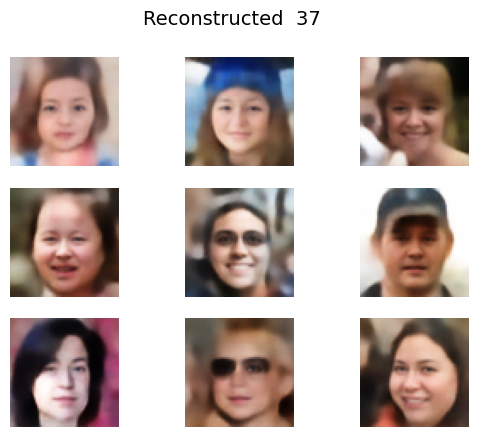


Epoch:  38
1/1 [==============================] - 0s 23ms/step


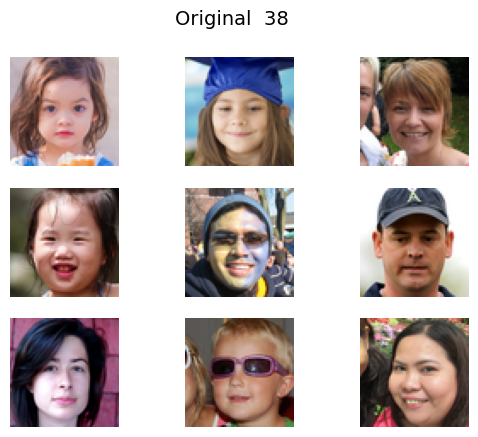

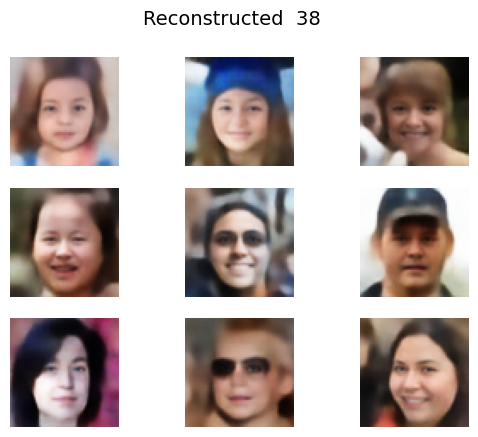


Epoch:  39
1/1 [==============================] - 0s 21ms/step


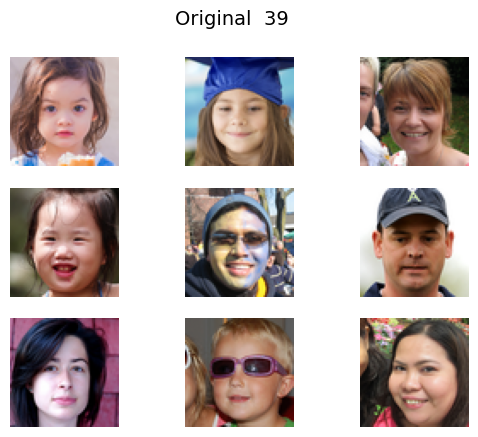

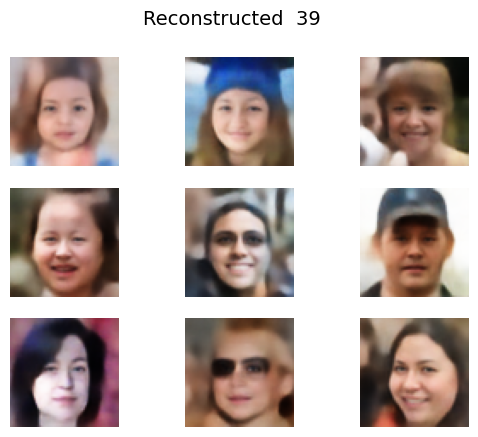


Epoch:  40
1/1 [==============================] - 0s 21ms/step


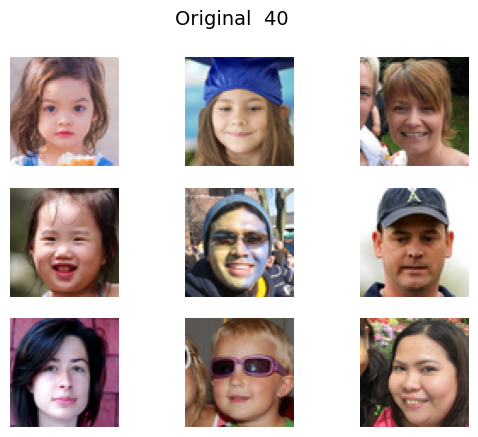

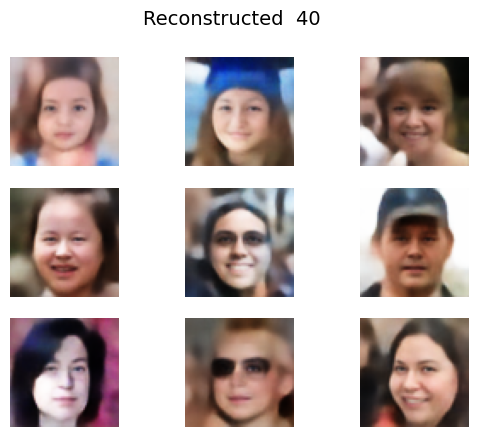


Epoch:  41
1/1 [==============================] - 0s 23ms/step


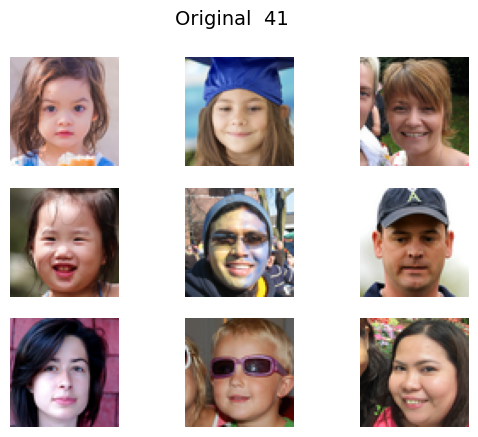

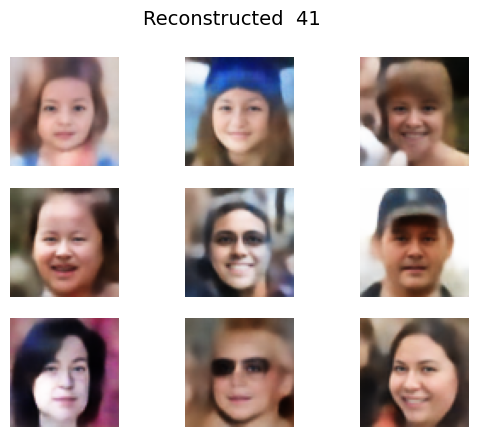


Epoch:  42
1/1 [==============================] - 0s 22ms/step


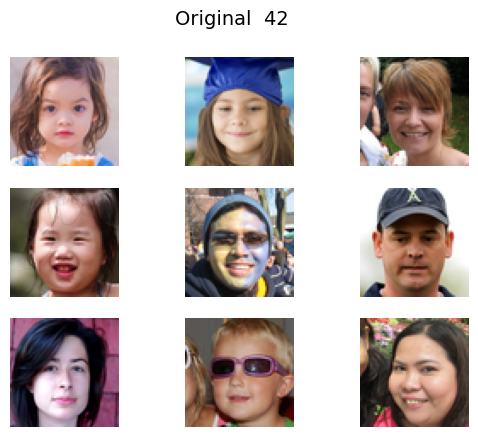

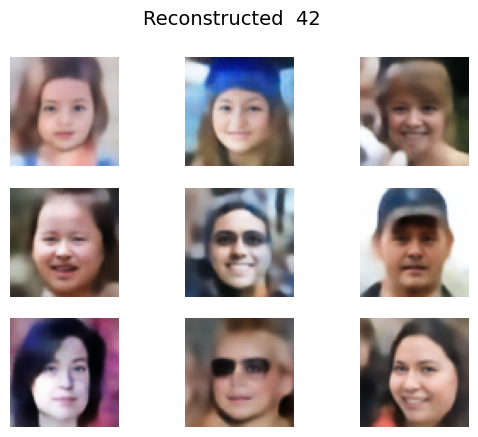


Epoch:  43
1/1 [==============================] - 0s 22ms/step


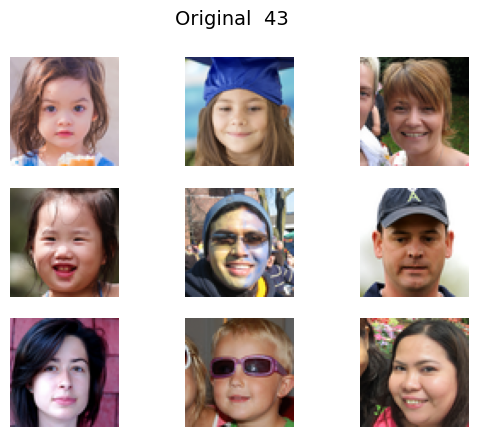

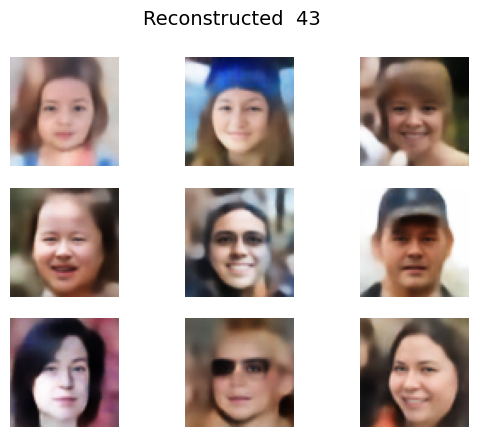


Epoch:  44
1/1 [==============================] - 0s 22ms/step


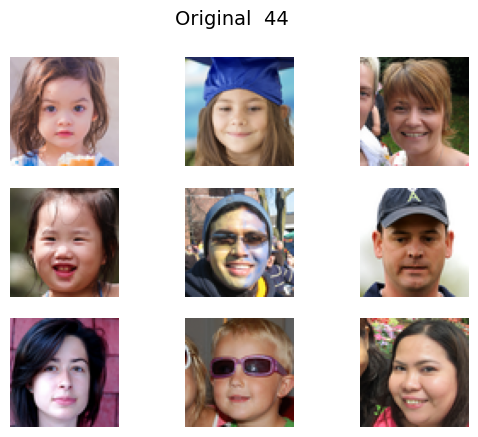

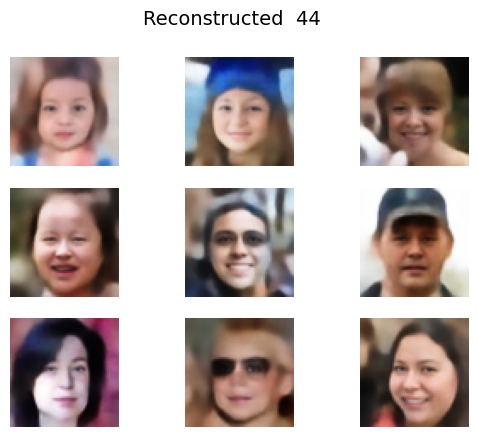


Epoch:  45
1/1 [==============================] - 0s 22ms/step


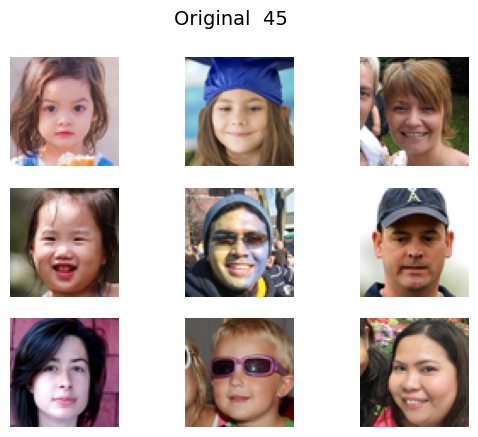

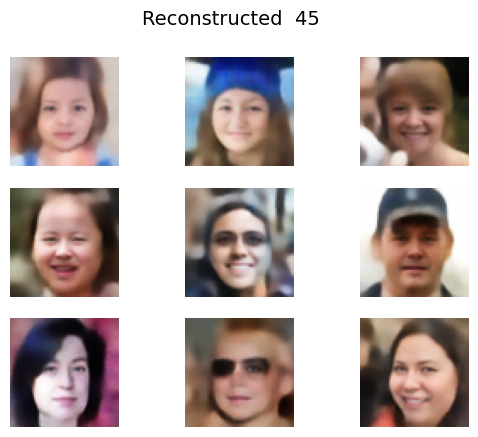


Epoch:  46
1/1 [==============================] - 0s 22ms/step


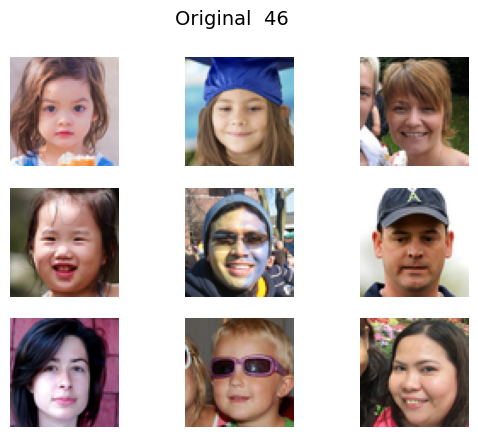

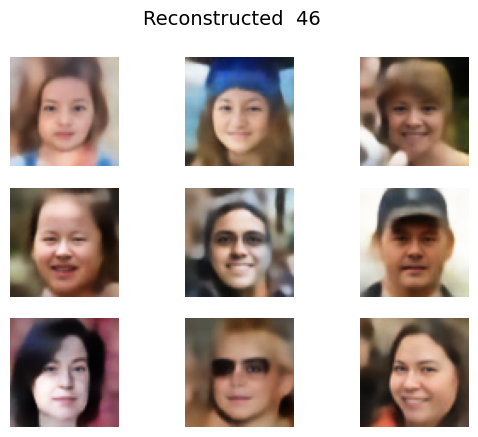


Epoch:  47
1/1 [==============================] - 0s 24ms/step


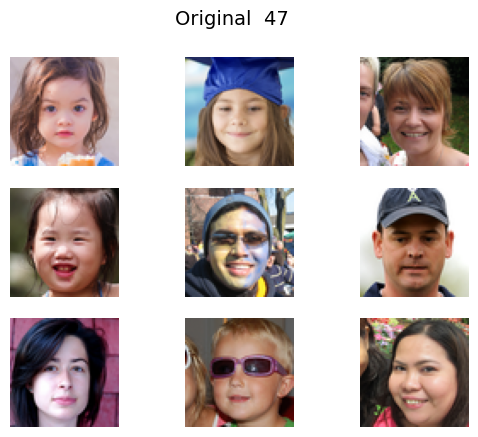

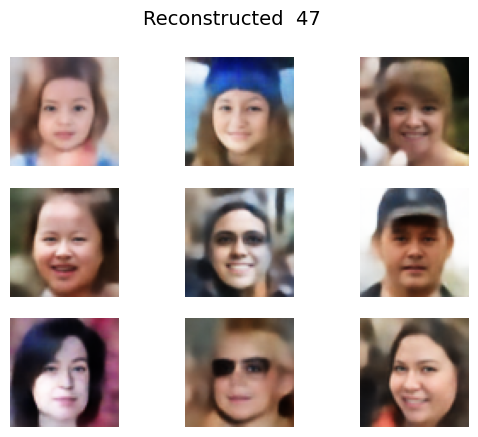


Epoch:  48
1/1 [==============================] - 0s 22ms/step


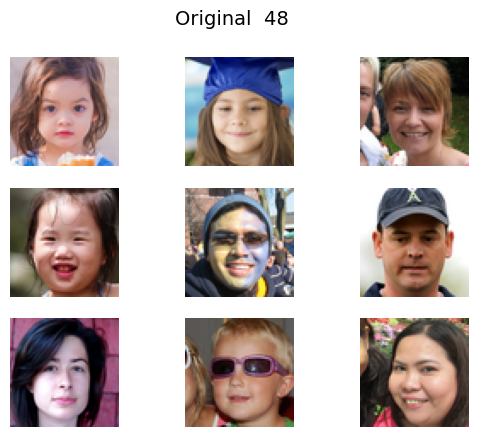

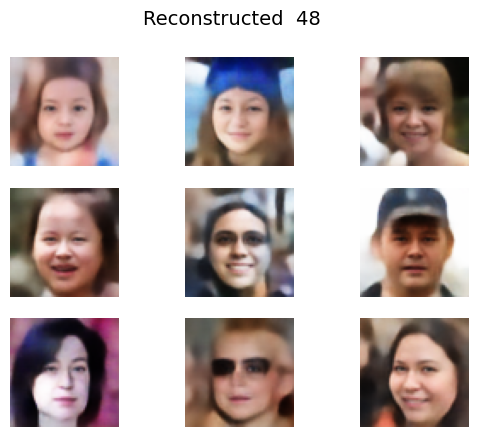


Epoch:  49
1/1 [==============================] - 0s 21ms/step


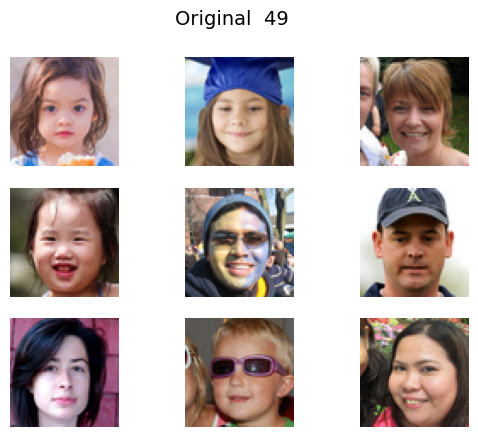

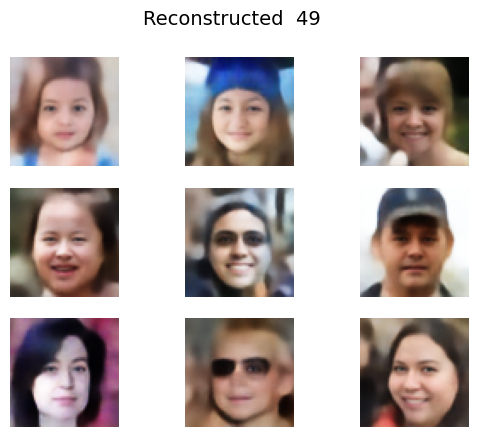

In [4]:
def build_convolutional_autoencoder(data_shape, latent_dim, filters=128):
    encoder = build_conv_net(in_shape=data_shape, out_shape=latent_dim, filters=filters)
    decoder = build_deconv_net(latent_dim, activation_out='sigmoid', filters=filters)

    # We connect encoder and decoder into a single model
    autoencoder = tf.keras.Sequential([encoder, decoder])

    # Binary crossentropy loss - pairwise comparison between input and output pixels
    autoencoder.compile(loss='binary_crossentropy', optimizer='adam')

    return autoencoder


# Defining the model dimensions and building it
image_size = dataset.shape[1:]
latent_dim = 512
num_filters = 128
cae = build_convolutional_autoencoder(image_size, latent_dim, num_filters)


## Training the Convolutional autoencoder to reconstruct images
for epoch in range(50):
    print('\nEpoch: ', epoch)

    # Note that (X=y) when training autoencoders!
    # In this case we only care about qualitative performance, we don't split into train/test sets
    cae.fit(x=dataset, y=dataset, epochs=1, batch_size=64)

    samples = dataset[:9]
    reconstructed = cae.predict(samples)
    grid_plot(samples, epoch, name='Original', n=3, save=False)
    grid_plot(reconstructed, epoch, name='Reconstructed', n=3, save=False)

*Note: You may experiment with the latent dimensionality and number of filters in your convolutional network to see how it affects the reconstruction quality. Remember that this also affects the size of the model and time it takes to train.*

---
---


## 2. 2. Variational Autoencoders (VAEs)

<img src="https://lilianweng.github.io/lil-log/assets/images/vae-gaussian.png" width="500">

#### Encoder network
This defines the approximate posterior distribution, which takes as input an observation and outputs a set of parameters for specifying the conditional distribution of the latent representation. In this example, we simply model the distribution as a diagonal Gaussian, and the network outputs the mean and log-variance parameters of a factorized Gaussian. We output log-variance instead of the variance directly for numerical stability.

#### Decoder network
This defines the conditional distribution of the observation $z$, which takes a latent sample $z$ as input and outputs the parameters for a conditional distribution of the observation. We model the latent distribution prior  as a unit Gaussian.

#### Reparameterization trick
To generate a sample  for the decoder during training, we can sample from the latent distribution defined by the parameters outputted by the encoder, given an input observation $z$. However, this sampling operation creates a bottleneck because backpropagation cannot flow through a random node.

To address this, we use a reparameterization trick. In our example, we approximate  using the decoder parameters and another parameter  as follows:

$$z = \mu + \sigma\epsilon$$

where $\mu$ and $\sigma$  represent the mean and standard deviation of a Gaussian distribution respectively. They can be derived from the decoder output. The  can be thought of as a random noise used to maintain stochasticity of $z$. We generate  from a standard normal distribution.

The latent variable  is now generated by a function of $\mu$ and $\sigma$ which would enable the model to backpropagate gradients in the encoder through $\mu$ and $\sigma$ respectively, while maintaining stochasticity through $\epsilon$.

#### Implementation

You can see how this trick is implemented below by creating a custom layer by sublassing tf.keras.layers.Layer.
It is then connected to the output of the original encoder architecture and an additional [KL](https://en.wikipedia.org/wiki/Kullback–Leibler_divergence) loss term is introduced.


In [216]:
class Sampling(tf.keras.layers.Layer):
    """
    Custom layer for the variational autoencoder
    It takes two vectors as input - one for means and other for variances of the latent variables described by a multimodal gaussian
    Its output is a latent vector randomly sampled from this distribution
    """
    def call(self, inputs):
        z_mean, z_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_var) * epsilon

def build_vae(data_shape, latent_dim, filters=128, hierarch_filters=False, KL_beta=1):

    # Building the encoder - starts with a simple downsampling convolutional network
    encoder = build_conv_net(data_shape, latent_dim*2, filters=filters, hierarch_filters=hierarch_filters)

    # Adding special sampling layer that uses the reparametrization trick
    z_mean = Dense(latent_dim)(encoder.output)
    z_var = Dense(latent_dim)(encoder.output)
    z = Sampling()([z_mean, z_var])

    # Connecting the two encoder parts
    encoder = tf.keras.Model(inputs=encoder.input, outputs=z)

    # Defining the decoder which is a regular upsampling deconvolutional network
    if hierarch_filters:
        dense_units = 2 * 2 * filters * 2**3
    else:
        dense_units = 2 * 2 * filters
    decoder = build_deconv_net(latent_dim, dense_units=dense_units, activation_out='sigmoid', filters=filters, hierarch_filters=hierarch_filters)
    vae = tf.keras.Model(inputs=encoder.input, outputs=decoder(z))

    # Define a custom layer for the KL loss calculation
    class KLLossLayer(tf.keras.layers.Layer):
        def call(self, inputs):
            z_mean, z_var = inputs
            kl_loss = -0.5 * tf.reduce_sum(z_var - tf.square(z_mean) - tf.exp(z_var) + 1)
            # Add the KL loss to the model's losses
            self.add_loss((kl_loss * KL_beta) / tf.cast(tf.keras.backend.prod(data_shape), tf.float32))
            return inputs  # Pass through the inputs unchanged

    # Apply the custom layer to z_mean and z_var
    _, _ = KLLossLayer()([z_mean, z_var])

    vae.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3), loss='binary_crossentropy')

    return encoder, decoder, vae

Model: "Encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 enc_input (Conv2D)          (None, 32, 32, 64)        1792      
                                                                 
 conv2d (Conv2D)             (None, 16, 16, 64)        36928     
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 64)          36928     
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 64)          36928     
                                                                 
 conv2d_3 (Conv2D)           (None, 2, 2, 64)          36928     
                                                                 
 flatten (Flatten)           (None, 256)               0   

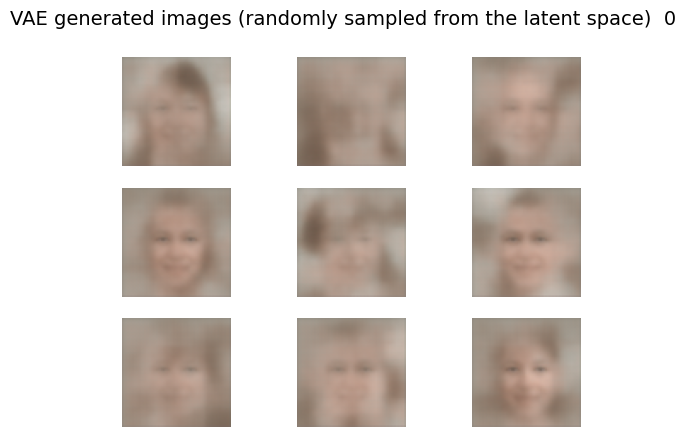

2500/2500 [==============================] - 32s 13ms/step - loss: 0.5662


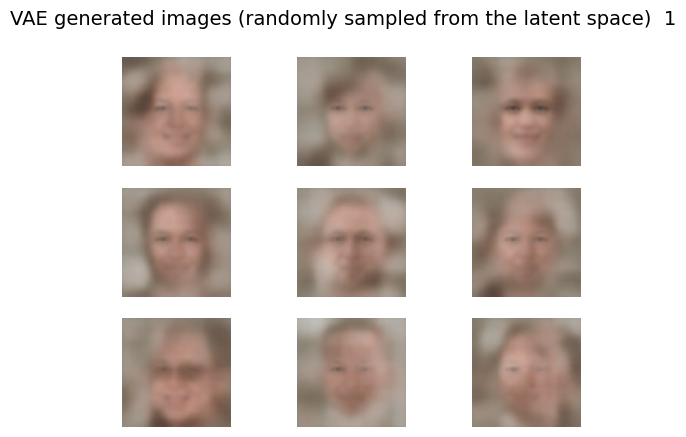

2500/2500 [==============================] - 29s 12ms/step - loss: 0.5597


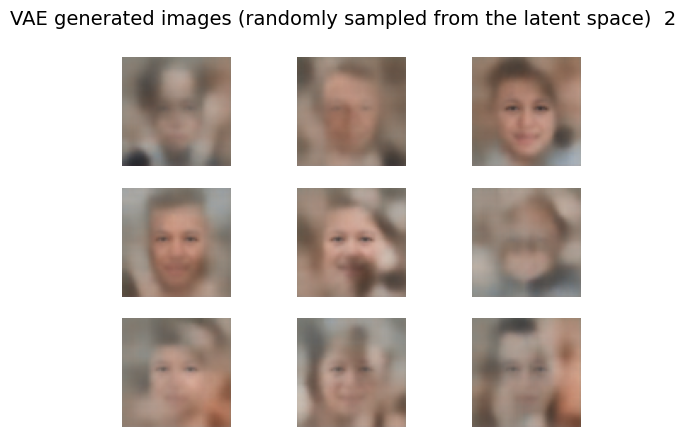

2500/2500 [==============================] - 29s 12ms/step - loss: 0.5558


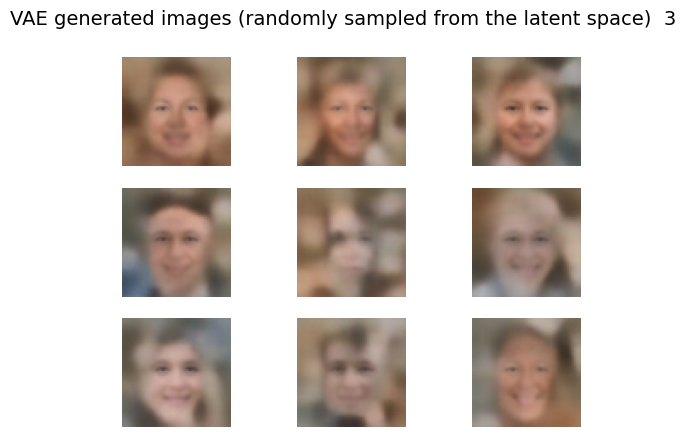

2500/2500 [==============================] - 31s 13ms/step - loss: 0.5539


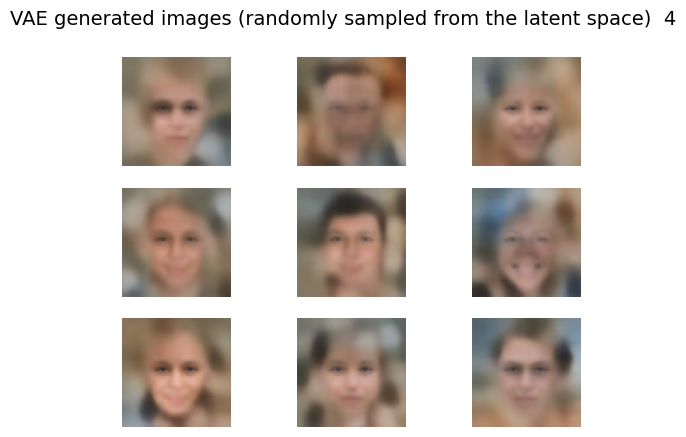

2500/2500 [==============================] - 32s 13ms/step - loss: 0.5526


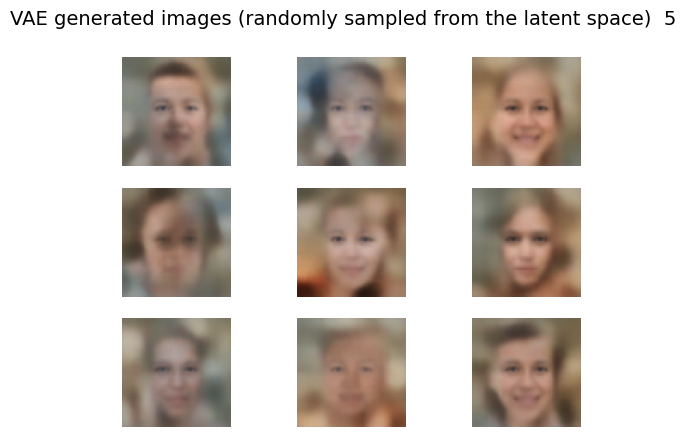

2500/2500 [==============================] - 30s 12ms/step - loss: 0.5518


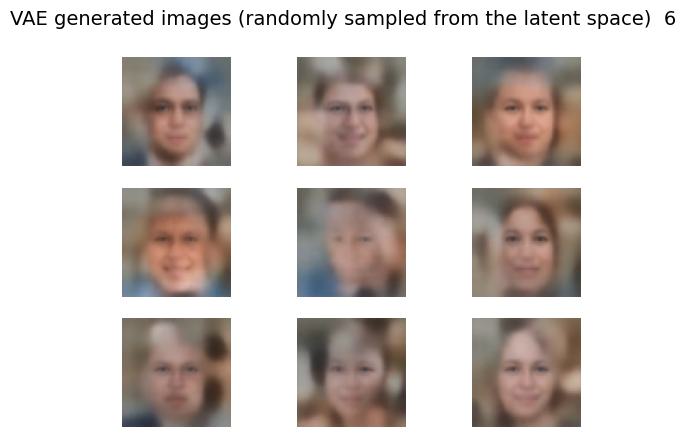

2500/2500 [==============================] - 29s 12ms/step - loss: 0.5511


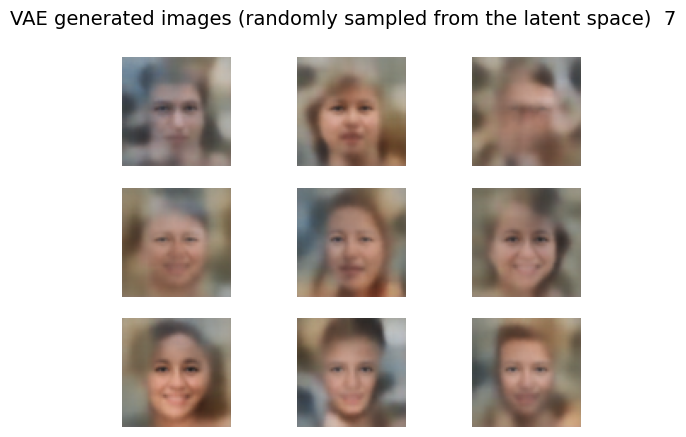

2500/2500 [==============================] - 31s 12ms/step - loss: 0.5505


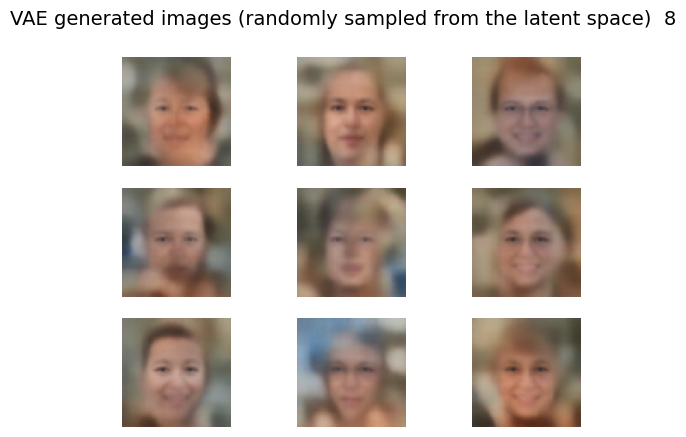

2500/2500 [==============================] - 31s 12ms/step - loss: 0.5501


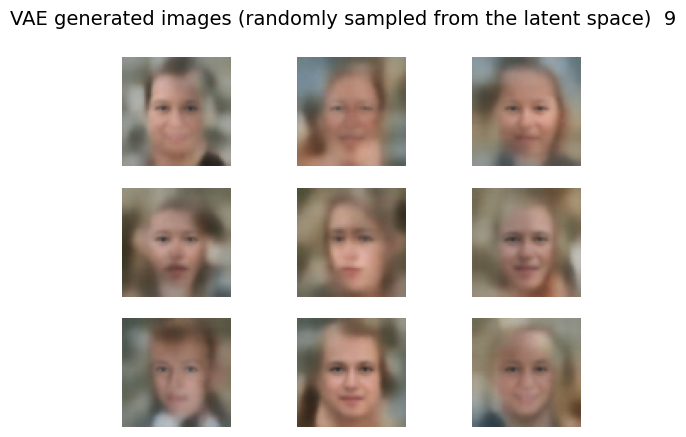

2500/2500 [==============================] - 31s 12ms/step - loss: 0.5497


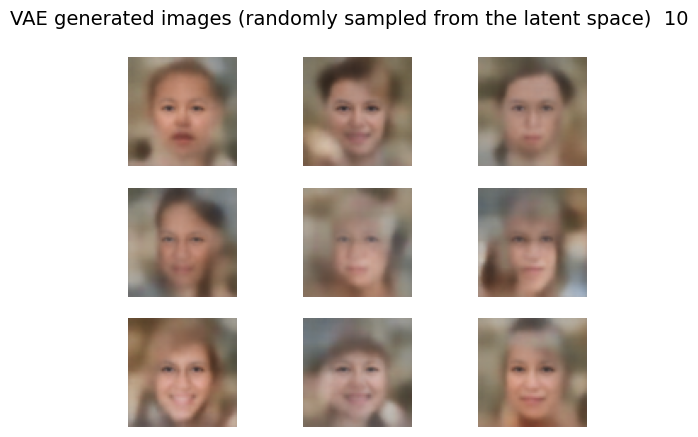

2500/2500 [==============================] - 30s 12ms/step - loss: 0.5494


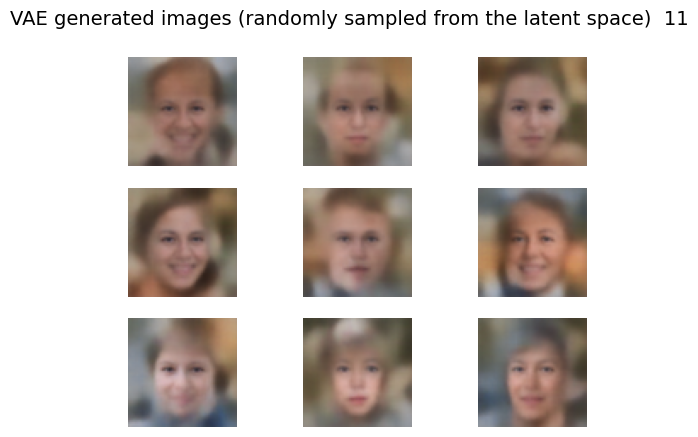

2500/2500 [==============================] - 33s 13ms/step - loss: 0.5492


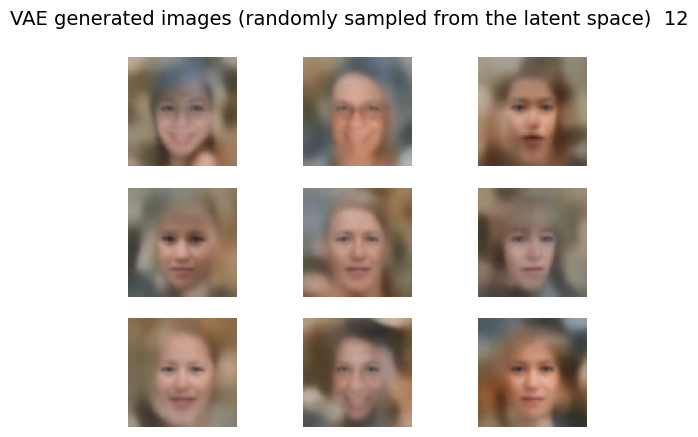

2500/2500 [==============================] - 32s 13ms/step - loss: 0.5490


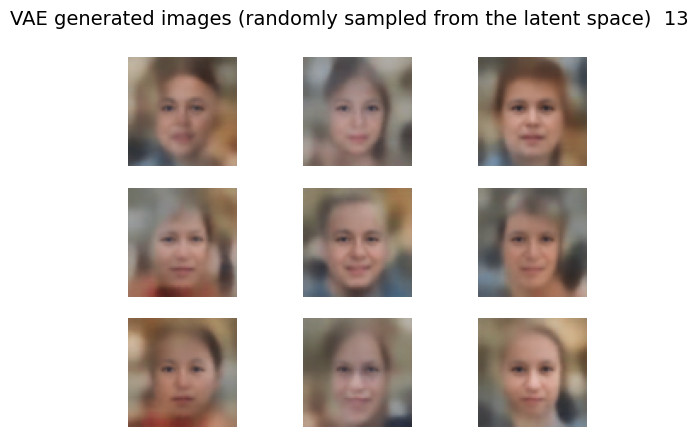

2500/2500 [==============================] - 30s 12ms/step - loss: 0.5489


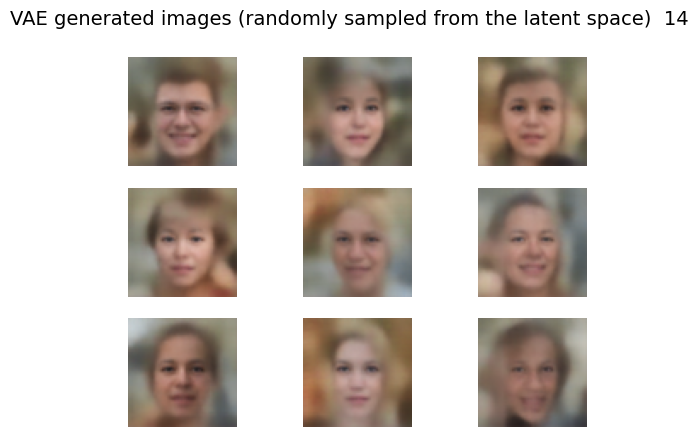

2500/2500 [==============================] - 31s 12ms/step - loss: 0.5488


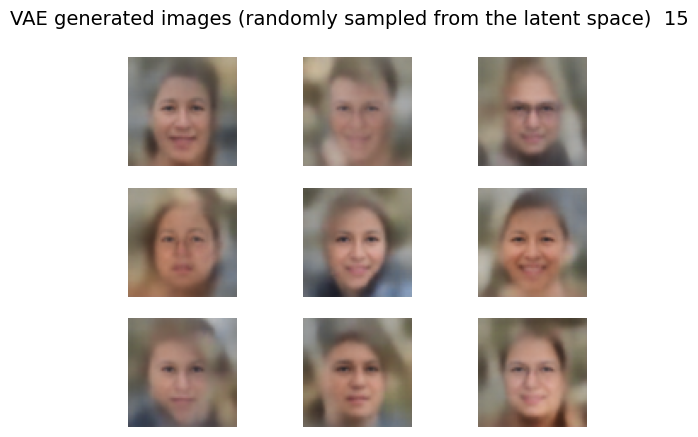

2500/2500 [==============================] - 33s 13ms/step - loss: 0.5487


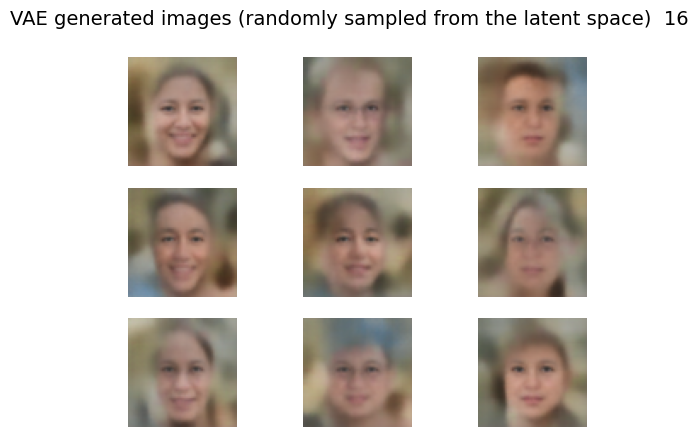

2500/2500 [==============================] - 30s 12ms/step - loss: 0.5486


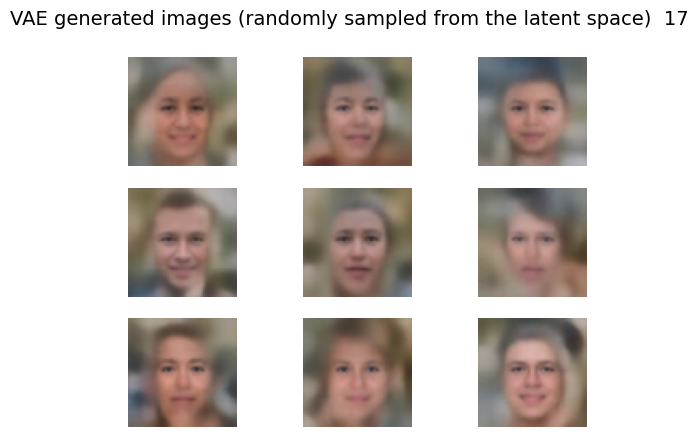

2500/2500 [==============================] - 30s 12ms/step - loss: 0.5485


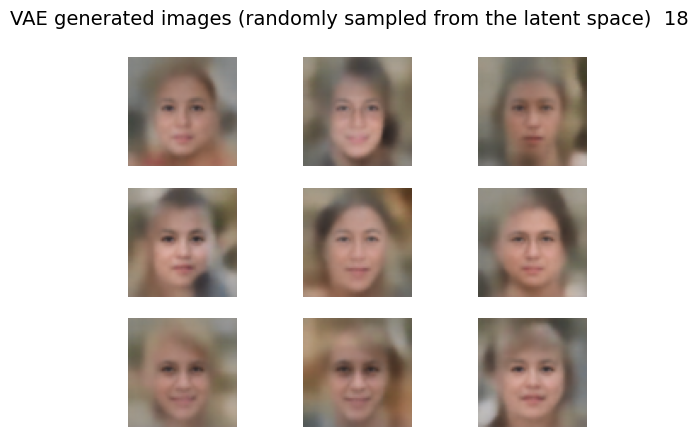

2500/2500 [==============================] - 32s 13ms/step - loss: 0.5484


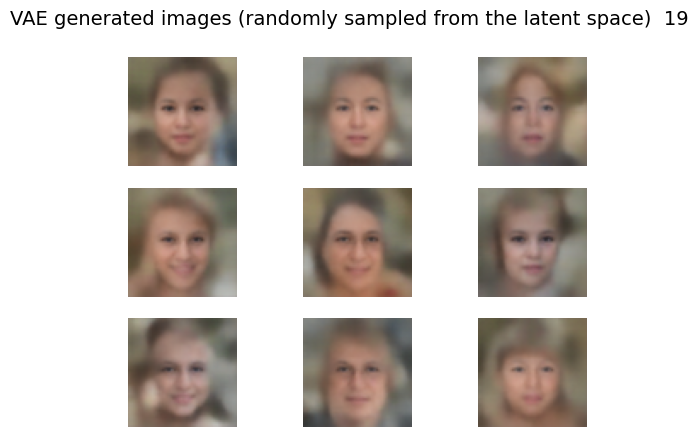

In [14]:
# Training the VAE model

latent_dim = 64
encoder, decoder, vae = build_vae(dataset.shape[1:], latent_dim, filters=64)

for epoch in range(20):
    vae.fit(x=dataset, y=dataset, epochs=1, batch_size=8)

    # Generate random vectors that we will use to sample from the learned latent space
    coefficient = 6                                 # You can tweak this coefficient to increase/decrease the std of the sampled vectors
    latent_vectors = np.random.randn(9, latent_dim) # Generate 9 random points in the latent space
    images = decoder(latent_vectors / coefficient)  # Feed the vectors scaled by the coefficient to the model
    grid_plot(images, epoch, name='VAE generated images (randomly sampled from the latent space)', n=3, save=False)

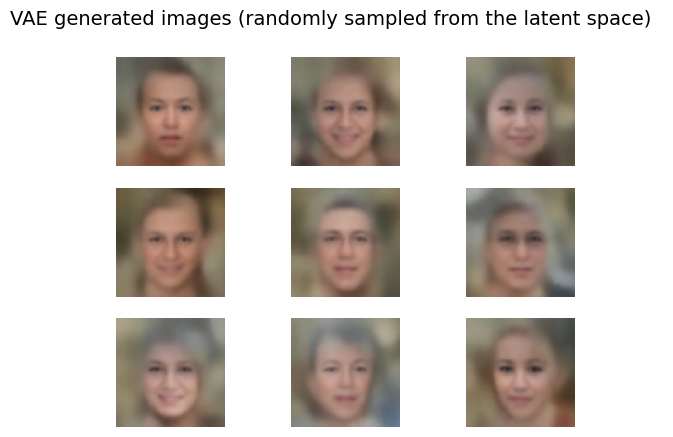

In [31]:
# Generate additional new images using the trained VAE model (to experiment with the scaling coefficient)
coefficient = 6
latent_vectors = np.random.randn(9, latent_dim)
images = decoder(latent_vectors / coefficient)
grid_plot(images, name='VAE generated images (randomly sampled from the latent space)', n=3, save=False)

*Note: again, you might experiment with the latent dimensionality, batch size and the architecture of your convolutional nets to see how it affects the generative capabilities of this model.*

---

## 2.3 Generative Adversarial Networks (GANs)

### GAN architecture
Generative adversarial networks consist of two models: a generative model and a discriminative model.

<img src="https://media.springernature.com/original/springer-static/image/chp%3A10.1007%2F978-1-4842-3679-6_8/MediaObjects/463582_1_En_8_Fig1_HTML.jpg" width="500">

**The discriminator** model is a classifier that determines whether a given image looks like a real image from the dataset or like an artificially created image. This is basically a binary classifier that will take the form of a normal convolutional neural network (CNN).
As an input this network will get samples both from the dataset that it is trained on and on the samples generated by the **generator**.

The **generator** model takes random input values (noise) and transforms them into images through a deconvolutional neural network.

Over the course of many training iterations, the weights and biases in the discriminator and the generator are trained through backpropagation. The discriminator learns to tell "real" images of handwritten digits apart from "fake" images created by the generator. At the same time, the generator uses feedback from the discriminator to learn how to produce convincing images that the discriminator can't distinguish from real images.




In [64]:
from tensorflow.keras.optimizers.legacy import Adam

def build_gan(data_shape, latent_dim, filters=128, lr=2e-4, beta_1=0.5):
    optimizer = Adam(learning_rate=lr, beta_1=beta_1)

    # Usually thew GAN generator has tanh activation function in the output layer
    generator = build_deconv_net(latent_dim, activation_out='tanh', filters=filters, gan_mode=True)

    # Build and compile the discriminator
    discriminator = build_conv_net(in_shape=data_shape, out_shape=1, filters=filters) # Single output for binary classification
    discriminator.compile(loss='binary_crossentropy', optimizer=optimizer)

    # End-to-end GAN model for training the generator
    discriminator.trainable = False
    true_fake_prediction = discriminator(generator.output)
    GAN = tf.keras.Model(inputs=generator.input, outputs=true_fake_prediction)
    GAN.compile(loss='binary_crossentropy', optimizer=optimizer)

    return discriminator, generator, GAN


### Definining custom functions for training your GANs

---




In [5]:
def get_batch(generator, dataset, batch_size=64):
    """
    Fetches one batch of data and ensures no memory leaks by using TensorFlow operations.
    """
    half_batch = batch_size // 2

    # Generate fake images
    latent_vectors = tf.random.normal(shape=(half_batch, latent_dim))
    fake_data = generator(latent_vectors, training=False)

    # Select real images
    idx = np.random.randint(0, dataset.shape[0], half_batch)
    real_data = dataset[idx]

    # Combine
    X = tf.concat([real_data, fake_data], axis=0)
    y = tf.concat([tf.ones((half_batch, 1)), tf.zeros((half_batch, 1))], axis=0)

    return X, y


def train_gan(generator, discriminator, gan, dataset, latent_dim, n_epochs=20, batch_size=64):
    """
    Train the GAN with memory-efficient updates and clear session management.
    """
    batches_per_epoch = dataset.shape[0] // batch_size

    for epoch in range(n_epochs):

        epoch_discriminator_loss = 0
        epoch_generator_loss = 0

        for batch in tqdm(range(batches_per_epoch)):
            # Train Discriminator
            X, y = get_batch(generator, dataset, batch_size)
            discriminator_loss = discriminator.train_on_batch(X, y)

            epoch_discriminator_loss += discriminator_loss

            # Train Generator
            latent_vectors = tf.random.normal(shape=(batch_size, latent_dim))
            y_gan = tf.ones((batch_size, 1))
            generator_loss = gan.train_on_batch(latent_vectors, y_gan)

            epoch_generator_loss += generator_loss

        # Average the losses for the epoch
        epoch_discriminator_loss /= batches_per_epoch
        epoch_generator_loss /= batches_per_epoch

        # Print epoch losses
        print(f"Epoch {epoch + 1}/{n_epochs} - "
              f"Discriminator Loss: {epoch_discriminator_loss:.4f}, "
              f"Generator Loss: {epoch_generator_loss:.4f}")

        # Generate and visualize after each epoch
        noise = tf.random.normal(shape=(9, latent_dim))
        generated_images = generator(noise, training=False)
        grid_plot(generated_images.numpy(), epoch, name='Generated Images', n=3)

        # Clear backend session to free memory
        tf.keras.backend.clear_session()


Model: "Decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256)]             0         
                                                                 
 dec_input (Dense)           (None, 1024)              263168    
                                                                 
 reshape (Reshape)           (None, 4, 4, 64)          0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 8, 8, 128)         73856     
 anspose)                                                        
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 16, 16, 128)       147584    
 Transpose)                                                      
                                                                 
 conv2d_transpose_2 (Conv2D  (None, 32, 32, 128)       1475

100%|██████████| 312/312 [00:14<00:00, 20.99it/s]


Epoch 1/20 - Discriminator Loss: 0.2999, Generator Loss: 2.8669


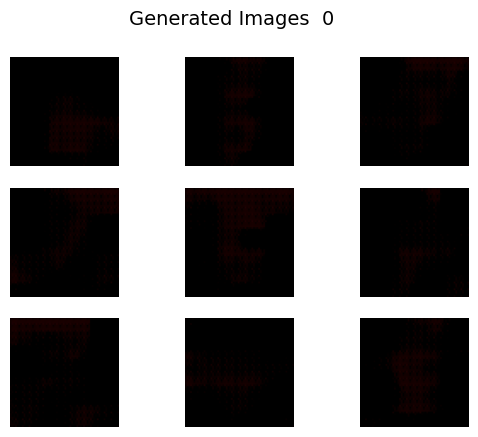

100%|██████████| 312/312 [00:14<00:00, 22.11it/s]


Epoch 2/20 - Discriminator Loss: 0.4444, Generator Loss: 1.9276


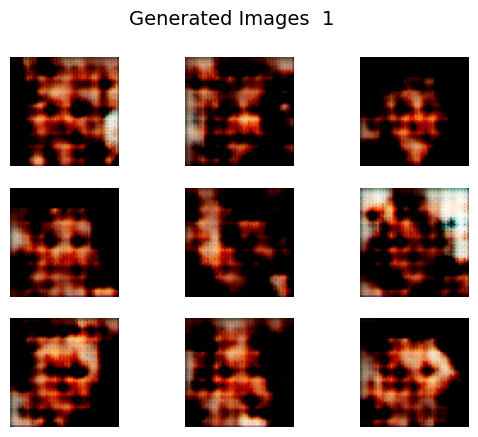

100%|██████████| 312/312 [00:13<00:00, 22.31it/s]


Epoch 3/20 - Discriminator Loss: 0.5021, Generator Loss: 1.4599


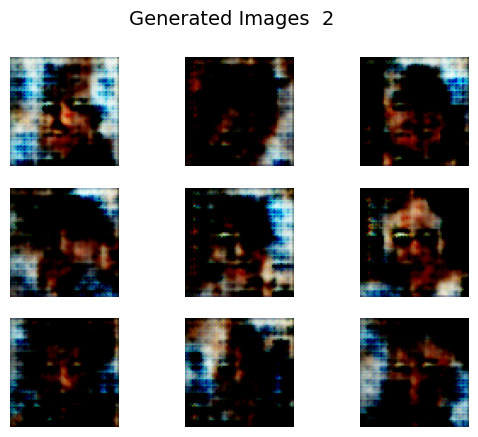

100%|██████████| 312/312 [00:14<00:00, 22.03it/s]


Epoch 4/20 - Discriminator Loss: 0.4687, Generator Loss: 1.6032


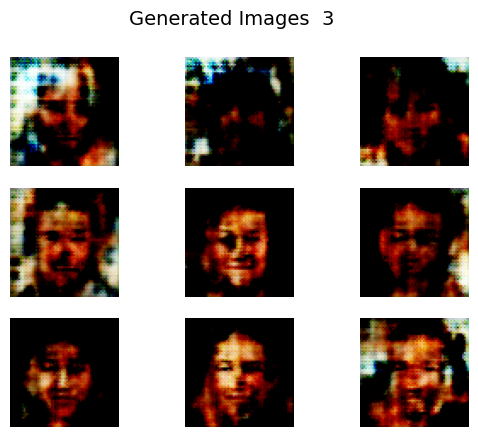

100%|██████████| 312/312 [00:14<00:00, 21.94it/s]


Epoch 5/20 - Discriminator Loss: 0.4459, Generator Loss: 1.7418


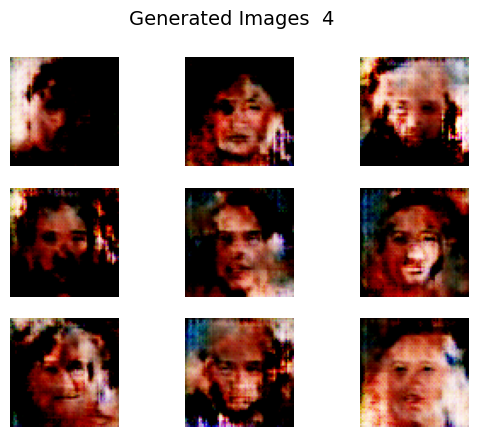

100%|██████████| 312/312 [00:14<00:00, 21.69it/s]


Epoch 6/20 - Discriminator Loss: 0.4468, Generator Loss: 1.6313


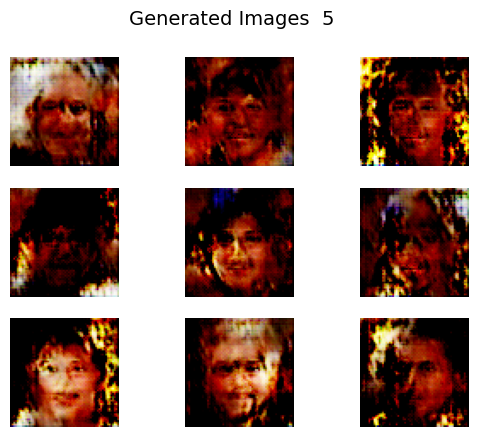

100%|██████████| 312/312 [00:14<00:00, 21.89it/s]


Epoch 7/20 - Discriminator Loss: 0.4234, Generator Loss: 1.7529


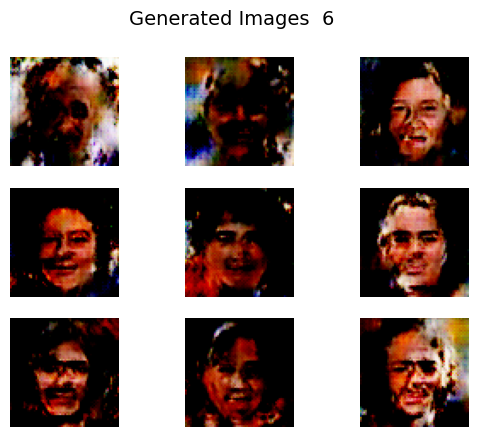

100%|██████████| 312/312 [00:14<00:00, 21.80it/s]


Epoch 8/20 - Discriminator Loss: 0.3921, Generator Loss: 1.9079


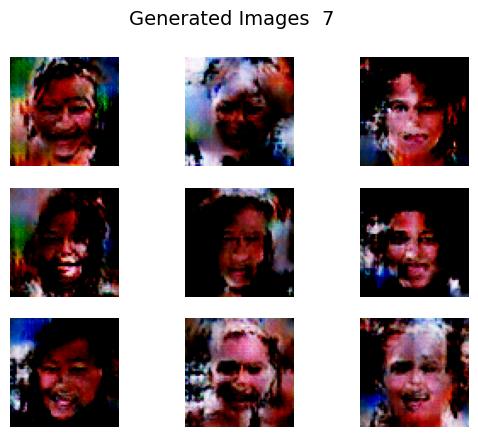

100%|██████████| 312/312 [00:14<00:00, 21.68it/s]


Epoch 9/20 - Discriminator Loss: 0.3913, Generator Loss: 1.9138


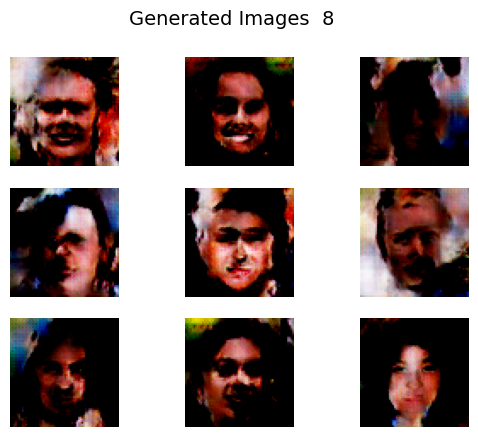

100%|██████████| 312/312 [00:14<00:00, 21.91it/s]


Epoch 10/20 - Discriminator Loss: 0.3711, Generator Loss: 1.9353


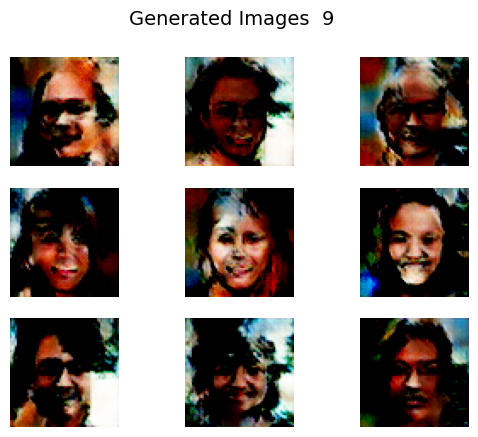

100%|██████████| 312/312 [00:14<00:00, 21.66it/s]


Epoch 11/20 - Discriminator Loss: 0.3747, Generator Loss: 2.0929


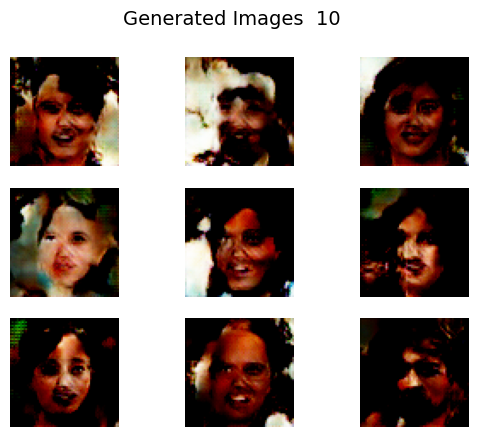

100%|██████████| 312/312 [00:14<00:00, 21.49it/s]


Epoch 12/20 - Discriminator Loss: 0.3763, Generator Loss: 2.0644


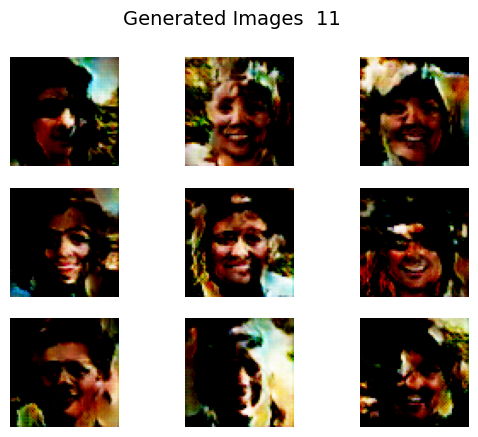

100%|██████████| 312/312 [00:14<00:00, 21.69it/s]


Epoch 13/20 - Discriminator Loss: 0.3800, Generator Loss: 1.9661


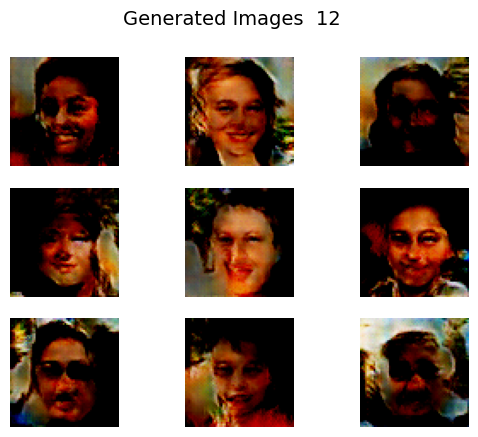

100%|██████████| 312/312 [00:14<00:00, 21.69it/s]


Epoch 14/20 - Discriminator Loss: 0.3935, Generator Loss: 1.8692


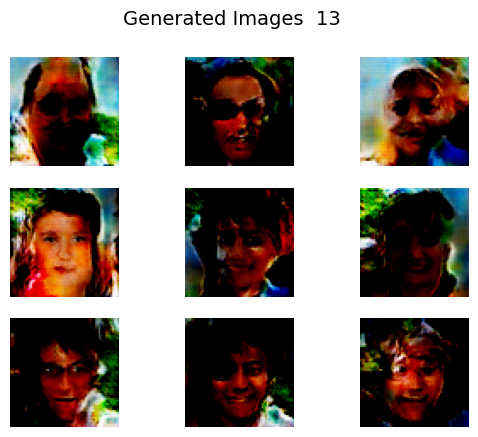

100%|██████████| 312/312 [00:14<00:00, 21.68it/s]


Epoch 15/20 - Discriminator Loss: 0.4013, Generator Loss: 1.7957


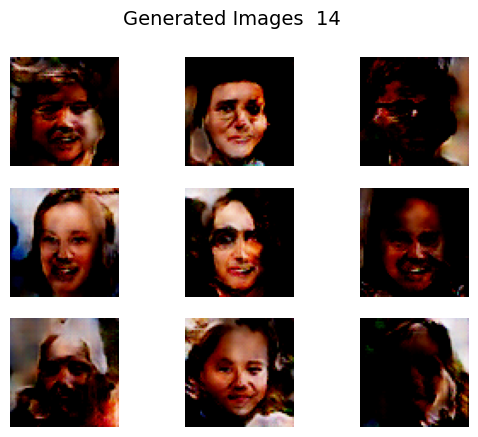

100%|██████████| 312/312 [00:14<00:00, 21.77it/s]


Epoch 16/20 - Discriminator Loss: 0.3925, Generator Loss: 1.8290


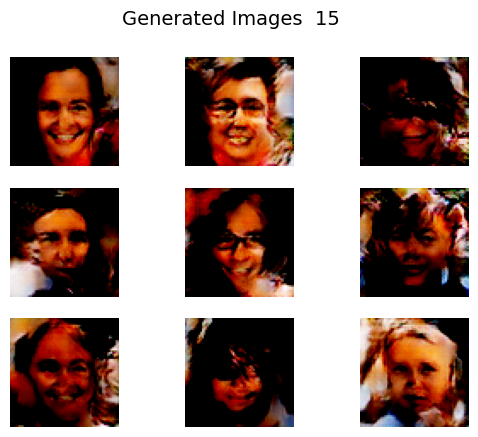

100%|██████████| 312/312 [00:14<00:00, 21.72it/s]


Epoch 17/20 - Discriminator Loss: 0.3954, Generator Loss: 1.8407


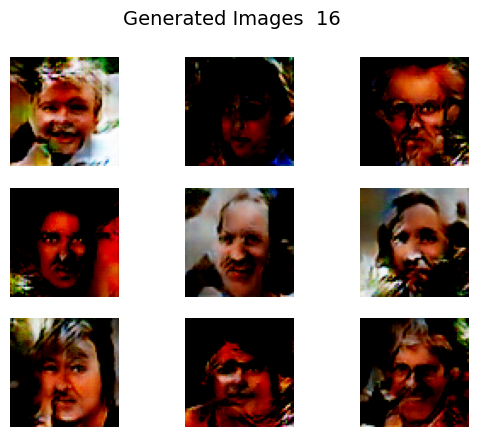

100%|██████████| 312/312 [00:14<00:00, 21.73it/s]


Epoch 18/20 - Discriminator Loss: 0.3745, Generator Loss: 1.8455


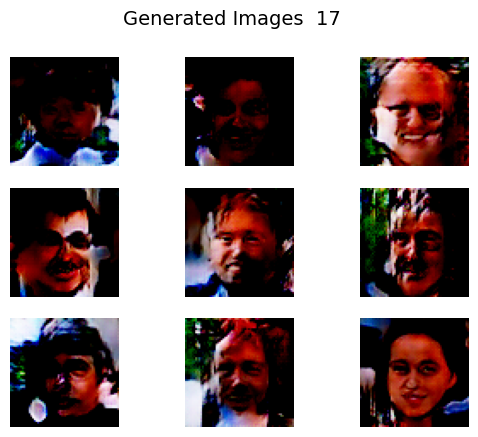

100%|██████████| 312/312 [00:14<00:00, 21.57it/s]


Epoch 19/20 - Discriminator Loss: 0.3808, Generator Loss: 1.8524


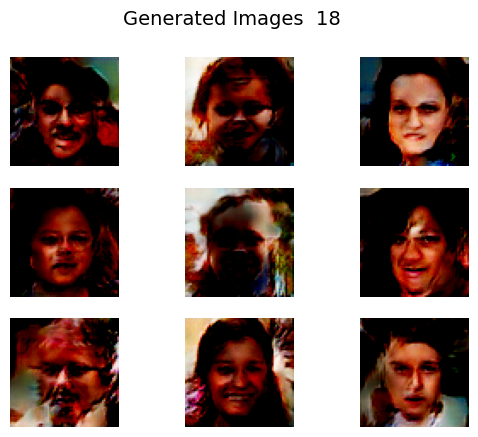

100%|██████████| 312/312 [00:14<00:00, 21.63it/s]


Epoch 20/20 - Discriminator Loss: 0.3769, Generator Loss: 1.8824


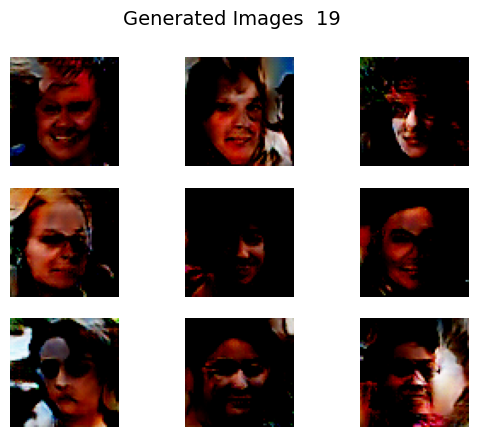

In [46]:
## Build and train the model (need around 10 epochs to start seeing some results)

latent_dim = 256
discriminator, generator, gan = build_gan(dataset.shape[1:], latent_dim, filters=128)
dataset_scaled = load_real_samples(data_path, scale=True)

train_gan(generator, discriminator, gan, dataset_scaled, latent_dim, n_epochs=20)

*Note: the samples generated by small GANs are more diverse, when compared to VAEs, however some samples might look strange and do not resemble the data the model was trained on.

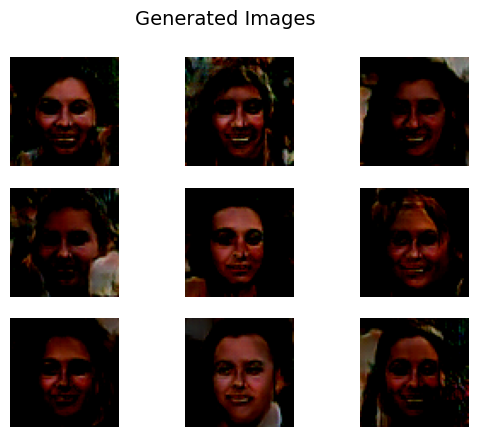

In [24]:
# Generate additional new images using the trained GAN model (to experiment with truncation)

def truncated_normal(mean=0, std=1, lower=-2, upper=2, size=1000):
    samples = []
    while len(samples) < size:
        sample = np.random.normal(mean, std, size=1)
        if lower <= sample <= upper:
            samples.append(sample)
    return np.array(samples)

truncated_noise = truncated_normal(mean=0, std=1, lower=-1, upper=1, size=9*latent_dim)
generated_images = generator(truncated_noise.reshape((9, latent_dim)), training=False)
grid_plot(generated_images.numpy(), name='Generated Images', n=3)

# Retraining the Generative Models (VAE and GAN ) on a Self-Chosen Dataset

For this part of the assignment, we chose the [Butterfly & Moths Image Classification Dataset](https://www.kaggle.com/datasets/gpiosenka/butterfly-images40-species), which features 12,594 training, 500 test, and 500 validation images (224x224x3; jpg format) of 100 butterfly/moth species. Here, we only use the training data.

To render the image dimensions consistent with those of the face images used above, we first preprocess the data.

After retraining the models, we systematically generate new data examples to explore their learned latent spaces.

In [961]:
from PIL import Image

def preprocess_images(input_dir, output_file, target_size=(64, 64)):
    """
    Preprocess images by loading, resizing, and saving them as a .npy file.
    """
    all_images = []

    # Iterate over subdirectories
    for subdir, _, files in os.walk(input_dir):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(subdir, file)

                # Open and resize the image
                with Image.open(file_path) as img:
                    img_resized = img.resize(target_size, Image.Resampling.LANCZOS)
                    img_array = np.array(img_resized)

                    all_images.append(img_array)

    # Convert the list of images to a numpy array
    image_tensor = np.stack(all_images, axis=0)

    # Save the tensor as a .npy file
    np.save(output_file, image_tensor)
    print(f"Processed images saved to {output_file}. Shape: {image_tensor.shape}")

input_directory = "/content/drive/My Drive/butterfly_dataset"
output_file = "processed_butterfly_images.npy"

preprocess_images(input_directory, output_file)

Processed images saved to processed_butterfly_images.npy. Shape: (12594, 64, 64, 3)


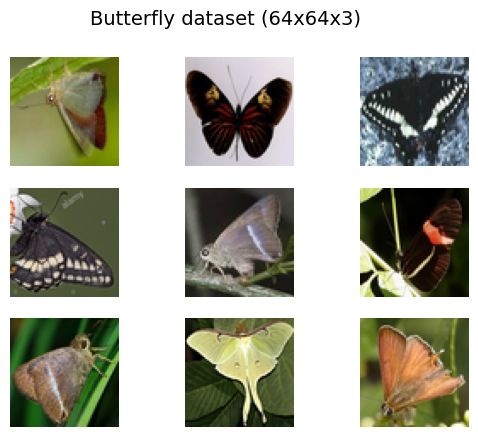

In [6]:
data_path = '/content/drive/My Drive/processed_butterfly_images.npy'

dataset = load_real_samples(data_path)
grid_plot(dataset[np.random.randint(0, 1000, 9)], name='Butterfly dataset (64x64x3)', n=3)

Model: "Encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_63 (InputLayer)       [(None, 64, 64, 3)]       0         
                                                                 
 enc_input (Conv2D)          (None, 32, 32, 32)        896       
                                                                 
 conv2d_124 (Conv2D)         (None, 16, 16, 32)        9248      
                                                                 
 conv2d_125 (Conv2D)         (None, 8, 8, 64)          18496     
                                                                 
 conv2d_126 (Conv2D)         (None, 4, 4, 128)         73856     
                                                                 
 conv2d_127 (Conv2D)         (None, 2, 2, 256)         295168    
                                                                 
 flatten_31 (Flatten)        (None, 1024)              0   

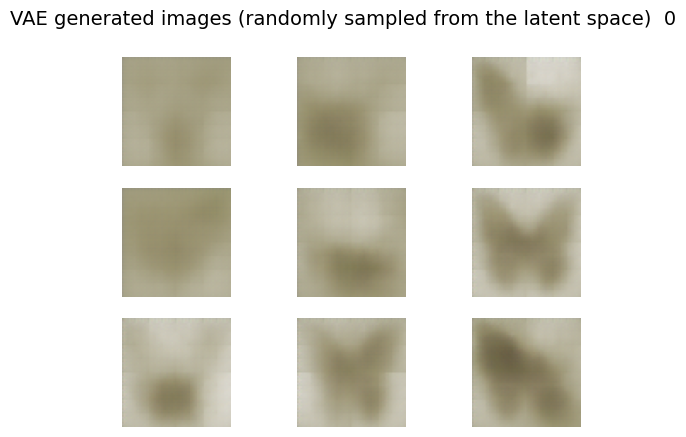

788/788 [==============================] - 6s 7ms/step - loss: 0.6007


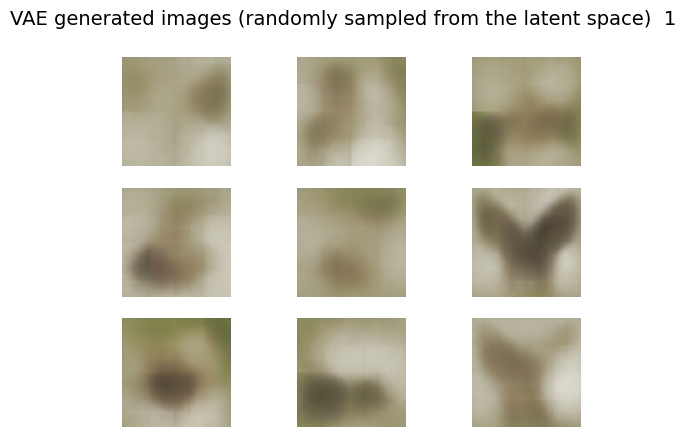

788/788 [==============================] - 6s 7ms/step - loss: 0.5935


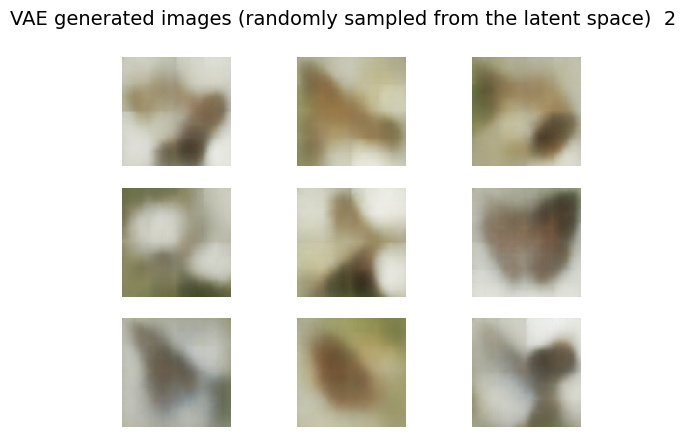

788/788 [==============================] - 6s 7ms/step - loss: 0.5884


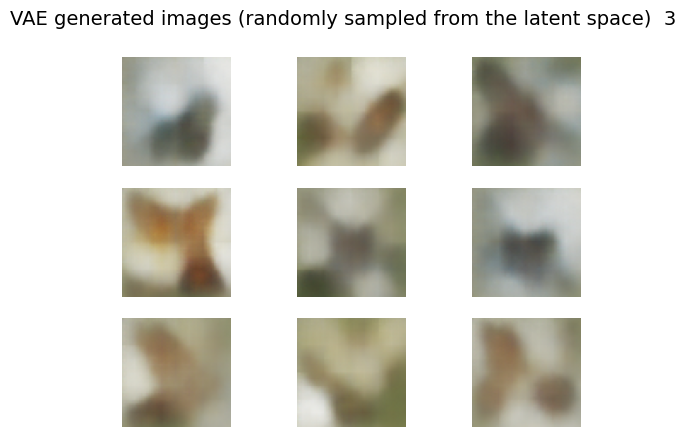

788/788 [==============================] - 6s 7ms/step - loss: 0.5869


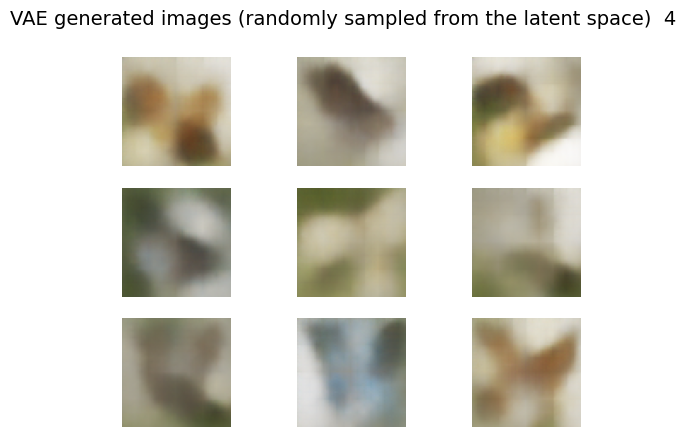

788/788 [==============================] - 6s 7ms/step - loss: 0.5854


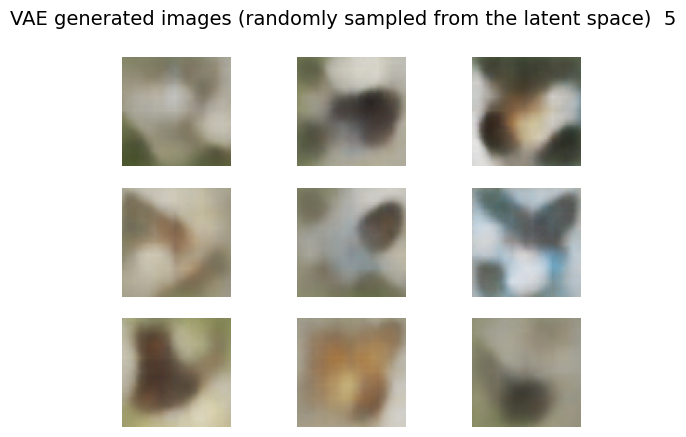

788/788 [==============================] - 6s 7ms/step - loss: 0.5847


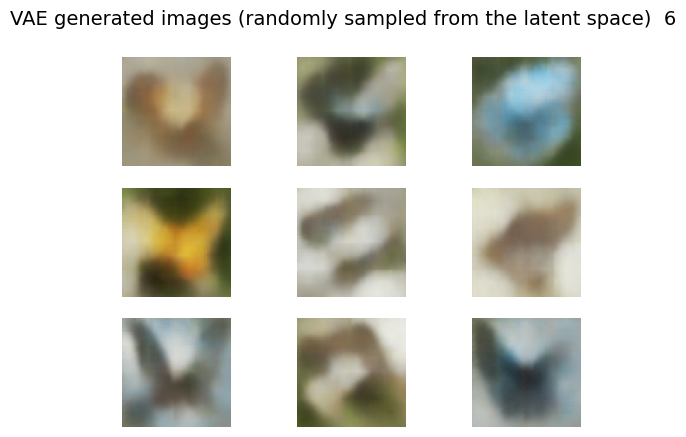

788/788 [==============================] - 6s 7ms/step - loss: 0.5841


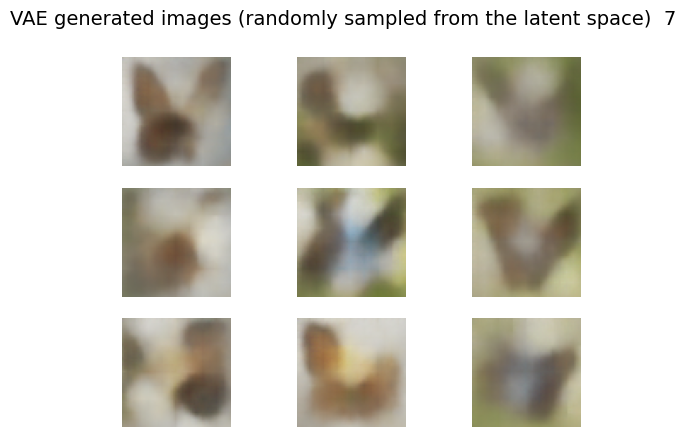

788/788 [==============================] - 6s 7ms/step - loss: 0.5832


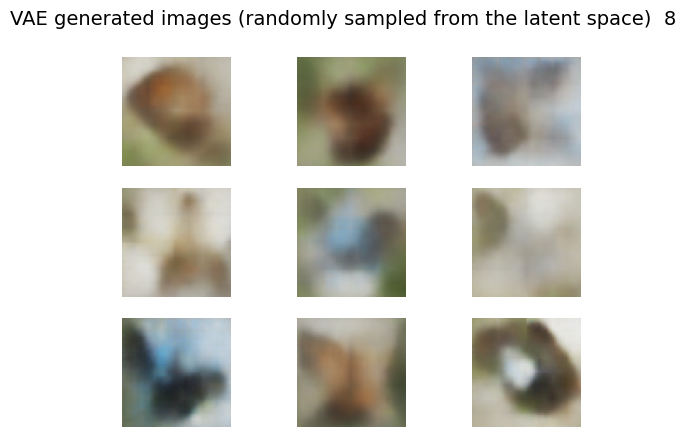

788/788 [==============================] - 6s 7ms/step - loss: 0.5831


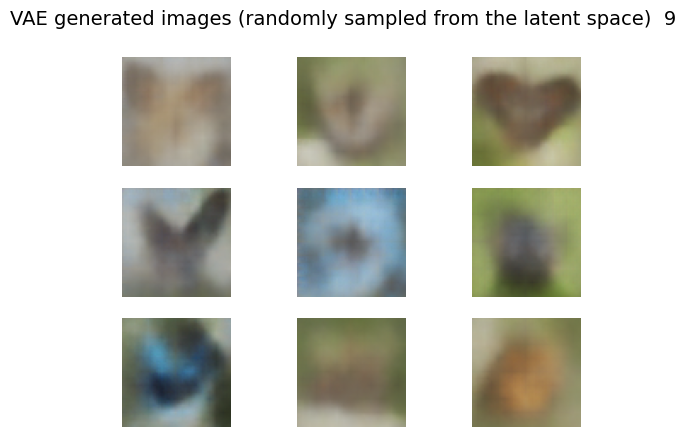

788/788 [==============================] - 6s 7ms/step - loss: 0.5825


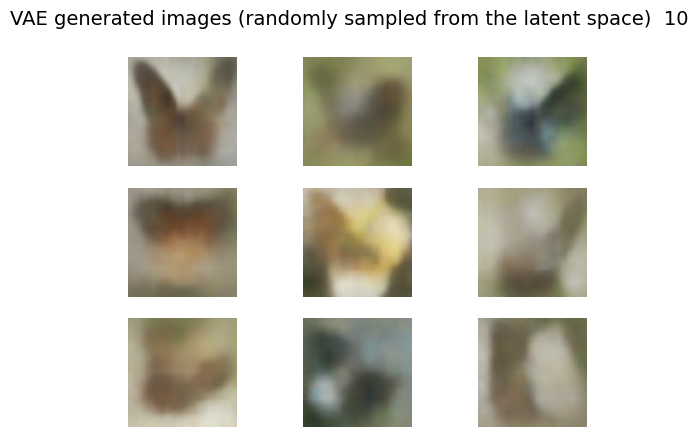

788/788 [==============================] - 6s 7ms/step - loss: 0.5821


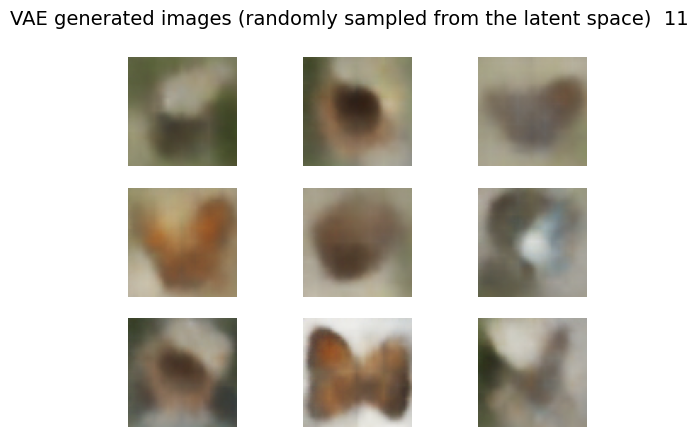

788/788 [==============================] - 6s 8ms/step - loss: 0.5817


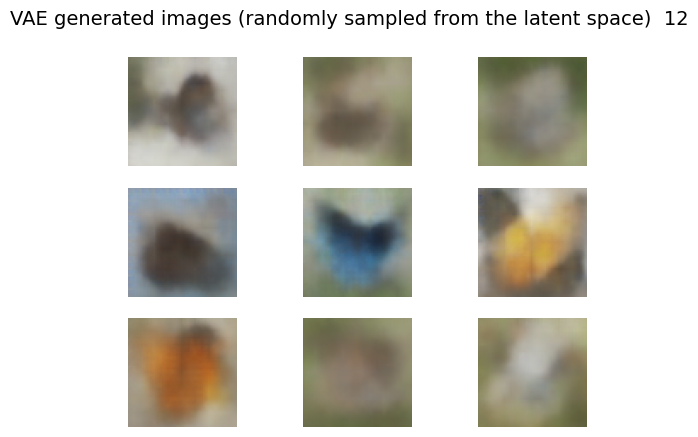

788/788 [==============================] - 6s 7ms/step - loss: 0.5811


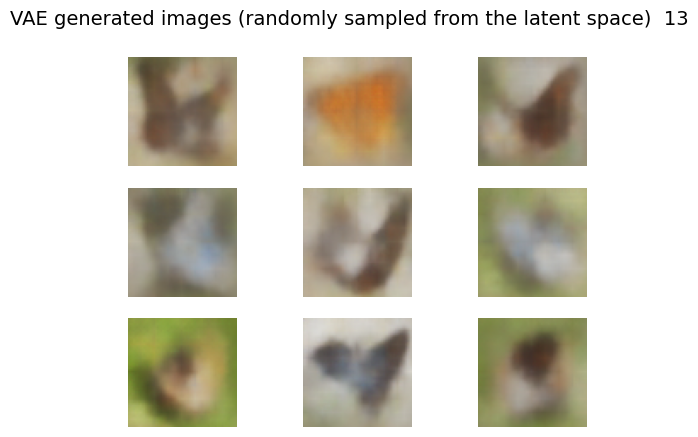

788/788 [==============================] - 6s 7ms/step - loss: 0.5809


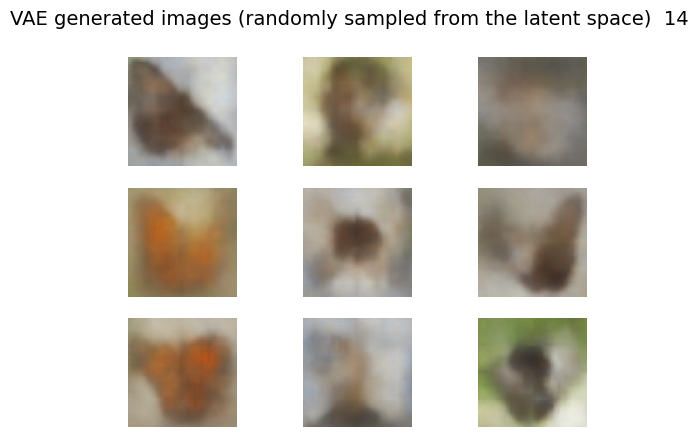

788/788 [==============================] - 6s 8ms/step - loss: 0.5806


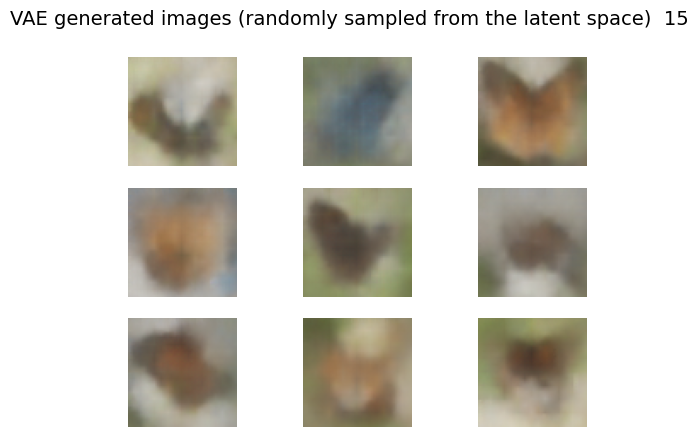

788/788 [==============================] - 6s 7ms/step - loss: 0.5802


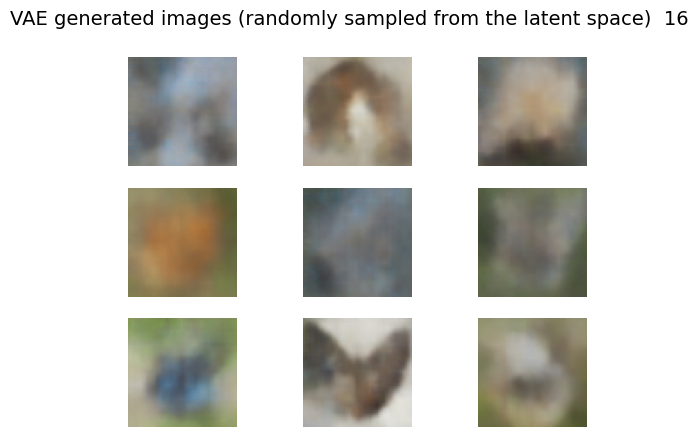

788/788 [==============================] - 6s 7ms/step - loss: 0.5799


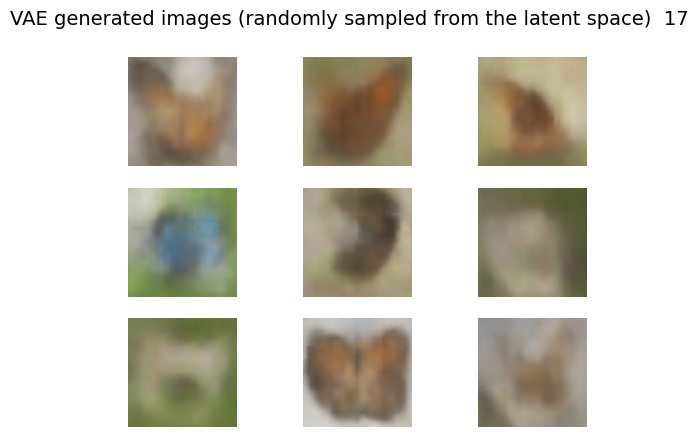

788/788 [==============================] - 6s 8ms/step - loss: 0.5797


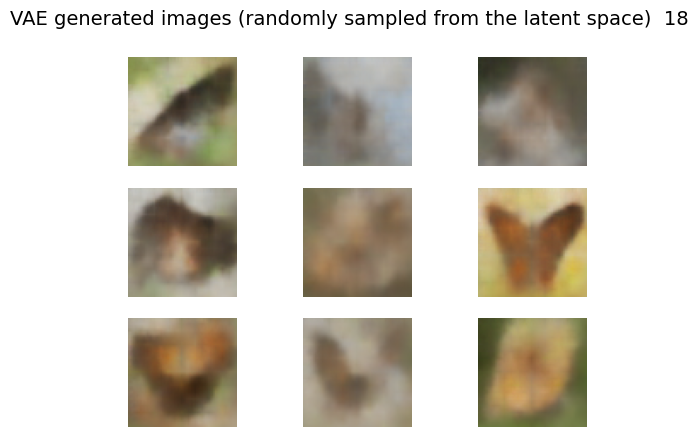

788/788 [==============================] - 6s 8ms/step - loss: 0.5792


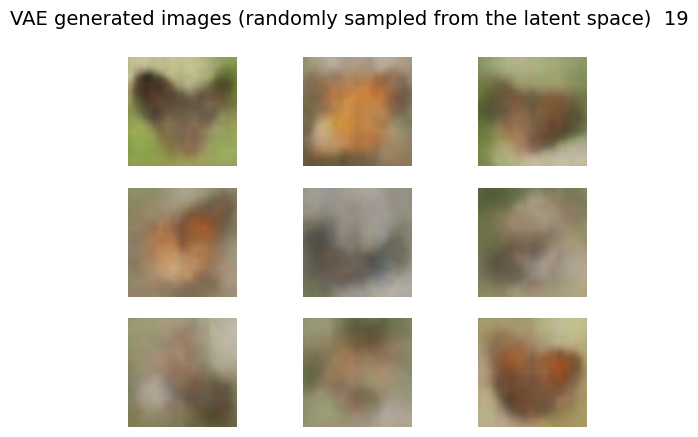

In [220]:
# Re-train the VAE model

latent_dim = 16
encoder, decoder, vae = build_vae(dataset.shape[1:], latent_dim, filters=32, hierarch_filters=True)

for epoch in range(20):
    vae.fit(x=dataset, y=dataset, epochs=1, batch_size=16)

    # Generate random vectors that we will use to sample from the learned latent space
    coefficient = 6                                 # You can tweak this coefficient to increase/decrease the std of the sampled vectors
    latent_vectors = np.random.randn(9, latent_dim) # Generate 9 random points in the latent space
    images = decoder(latent_vectors / coefficient)  # Feed the vectors scaled by the coefficient to the model
    grid_plot(images, epoch, name='VAE generated images (randomly sampled from the latent space)', n=3, save=False)

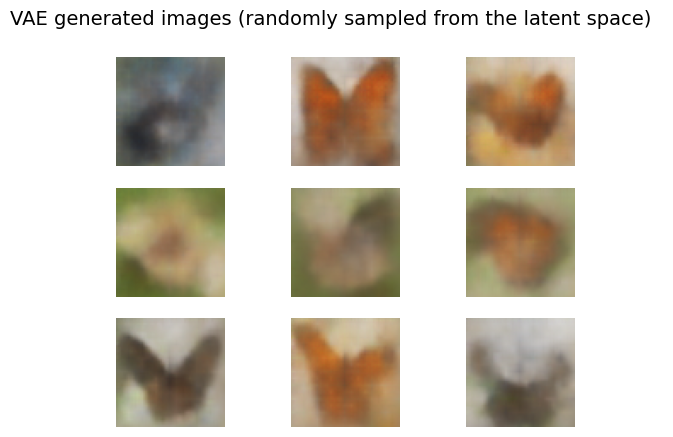

In [227]:
# Generate additional new images using the trained VAE model (to experiment with the scaling coefficient)
coefficient = 6
latent_vectors = np.random.randn(9, latent_dim)
images = decoder(latent_vectors / coefficient)
grid_plot(images, name='VAE generated images (randomly sampled from the latent space)', n=3, save=False)

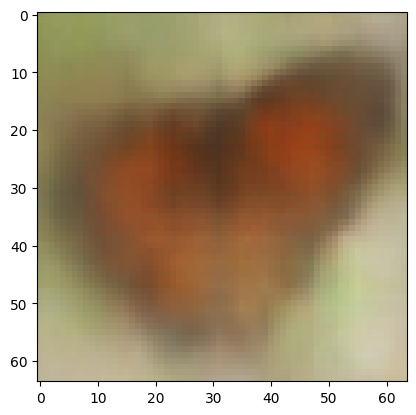

In [751]:
# Generate image1 for subsequent interpolation
coefficient = 6
latent_vector1 = np.random.randn(1, latent_dim)
image1 = decoder(latent_vector1 / coefficient)

plt.imshow(image1[0])

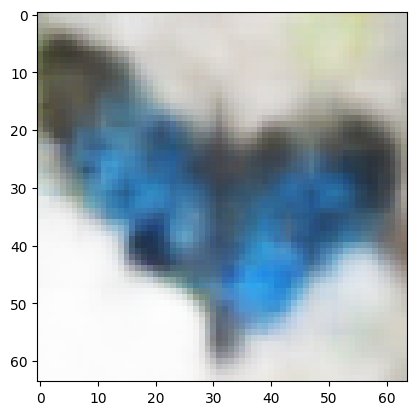

In [399]:
# Generate image2 for subsequent interpolation
coefficient = 6
latent_vector2 = np.random.randn(1, latent_dim)
image2 = decoder(latent_vector2 / coefficient)

plt.imshow(image2[0])

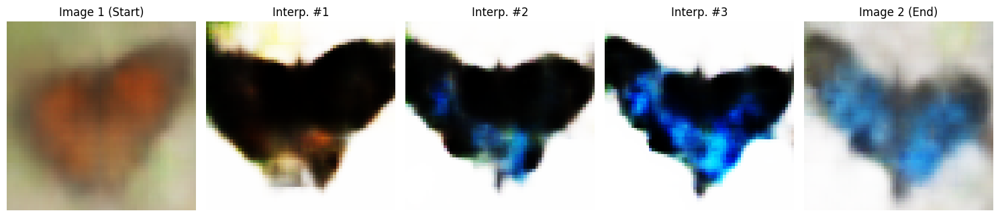

In [960]:
# Number of interpolated points
num_interpolations = 3

# Interpolation coefficients (evenly spaced between 0 and 1)
alphas = np.linspace(0, 1, num_interpolations + 2)  # Includes start and end

# Interpolate in latent space
interpolated_latent_vectors = np.array([latent_vector1 * (1 - alpha) + latent_vector2 * alpha for alpha in alphas]).round(3)

# Decode the interpolated latent vectors
interpolated_images = [decoder(vector) for vector in interpolated_latent_vectors]

# Plot the results
plt.figure(figsize=(15, 5))

# Plot the first image explicitly
plt.subplot(1, len(interpolated_images), 1)
plt.imshow(image1[0])
plt.title("Image 1 (Start)")
plt.axis("off")

# Plot the interpolated images
for i, image in enumerate(interpolated_images[1:-1], start=2):  # Skip first and last
    plt.subplot(1, len(interpolated_images), i)
    plt.imshow(image[0])
    plt.title(f"Interp. #{i-1}")
    plt.axis("off")

# Plot the last image explicitly
plt.subplot(1, len(interpolated_images), len(interpolated_images))
plt.imshow(image2[0])
plt.title("Image 2 (End)")
plt.axis("off")

plt.tight_layout()
plt.show()

Model: "Decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 16)]              0         
                                                                 
 dec_input (Dense)           (None, 1024)              17408     
                                                                 
 reshape (Reshape)           (None, 4, 4, 64)          0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 8, 8, 64)          36928     
 anspose)                                                        
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 16, 16, 64)        36928     
 Transpose)                                                      
                                                                 
 conv2d_transpose_2 (Conv2D  (None, 32, 32, 64)        3692

100%|██████████| 393/393 [00:14<00:00, 27.62it/s]


Epoch 1/20 - Discriminator Loss: 0.2978, Generator Loss: 3.3956


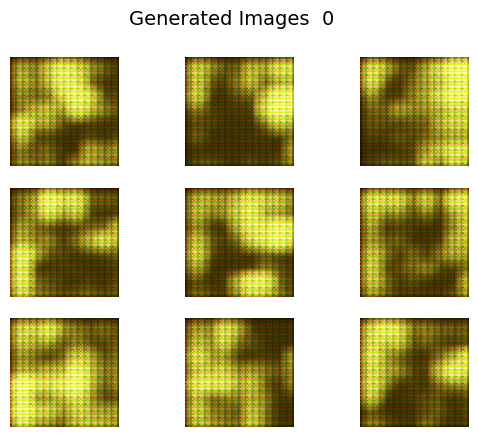

100%|██████████| 393/393 [00:13<00:00, 28.69it/s]


Epoch 2/20 - Discriminator Loss: 0.2052, Generator Loss: 3.3878


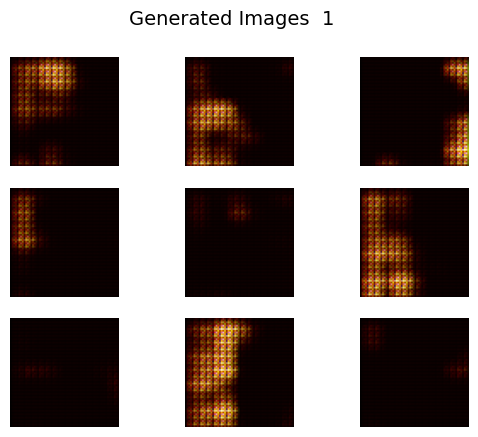

100%|██████████| 393/393 [00:13<00:00, 29.07it/s]


Epoch 3/20 - Discriminator Loss: 0.3317, Generator Loss: 2.3377


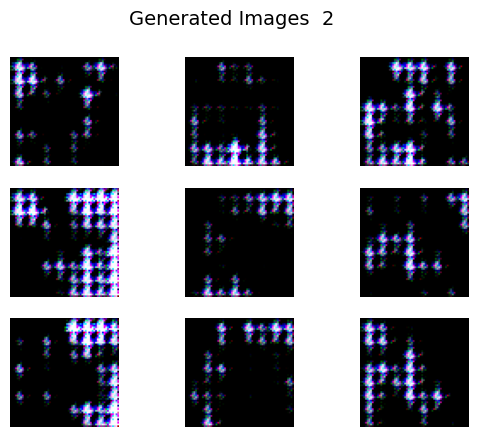

100%|██████████| 393/393 [00:14<00:00, 27.61it/s]


Epoch 4/20 - Discriminator Loss: 0.4500, Generator Loss: 1.5571


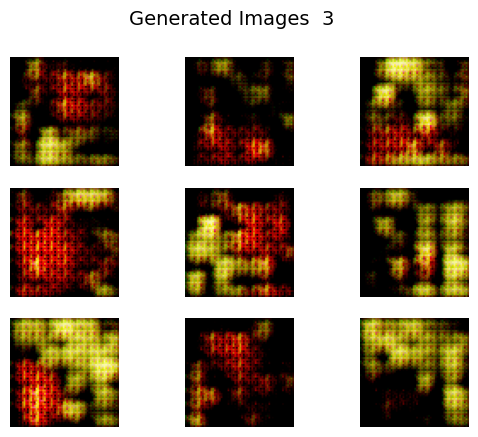

100%|██████████| 393/393 [00:13<00:00, 28.60it/s]


Epoch 5/20 - Discriminator Loss: 0.5291, Generator Loss: 1.3893


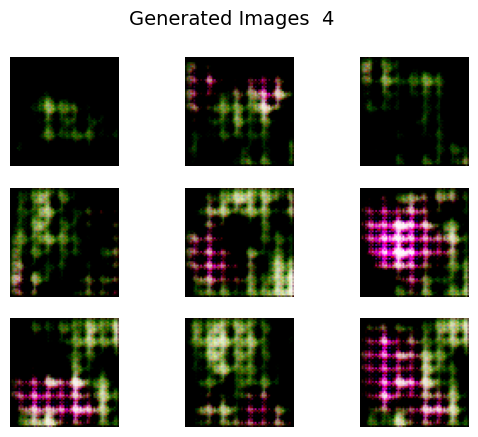

100%|██████████| 393/393 [00:13<00:00, 28.56it/s]


Epoch 6/20 - Discriminator Loss: 0.4864, Generator Loss: 1.5410


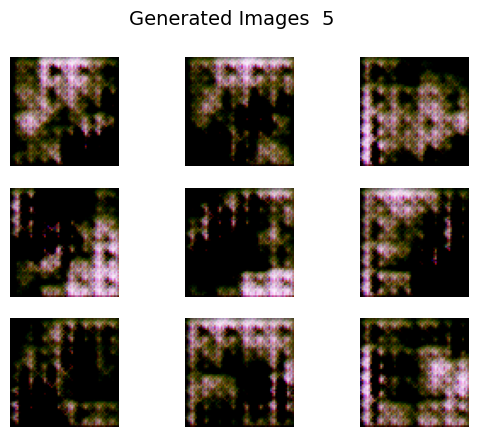

100%|██████████| 393/393 [00:13<00:00, 28.65it/s]


Epoch 7/20 - Discriminator Loss: 0.4079, Generator Loss: 1.8940


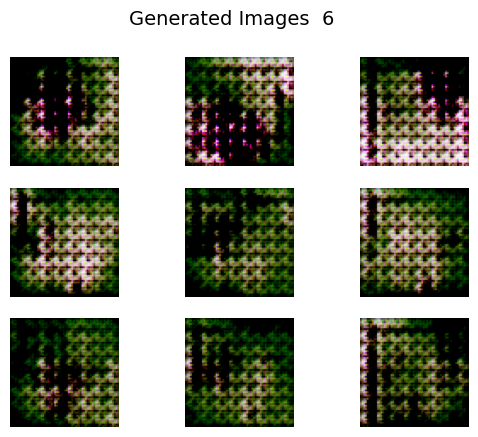

100%|██████████| 393/393 [00:13<00:00, 28.82it/s]


Epoch 8/20 - Discriminator Loss: 0.4954, Generator Loss: 1.4535


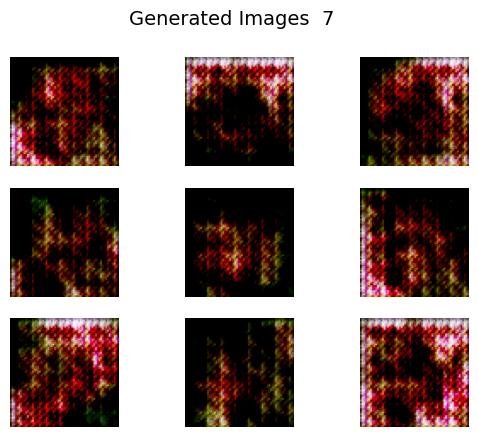

100%|██████████| 393/393 [00:13<00:00, 28.82it/s]


Epoch 9/20 - Discriminator Loss: 0.4728, Generator Loss: 1.6443


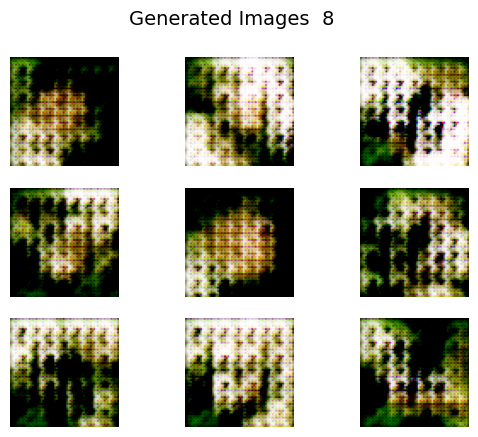

100%|██████████| 393/393 [00:13<00:00, 28.58it/s]


Epoch 10/20 - Discriminator Loss: 0.5000, Generator Loss: 1.4408


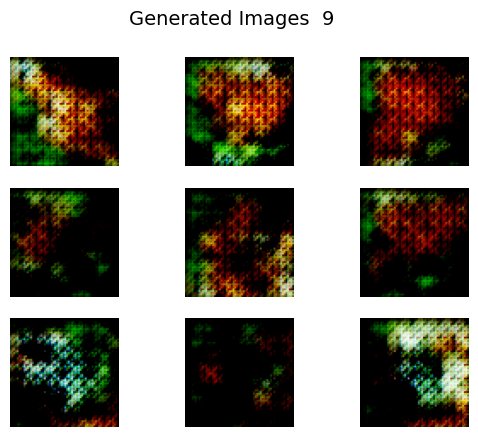

100%|██████████| 393/393 [00:13<00:00, 28.74it/s]


Epoch 11/20 - Discriminator Loss: 0.5083, Generator Loss: 1.4288


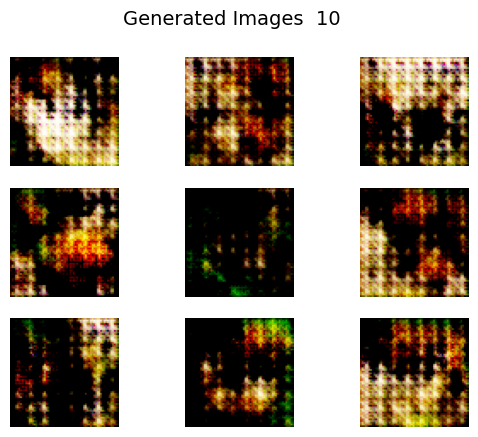

100%|██████████| 393/393 [00:13<00:00, 28.87it/s]


Epoch 12/20 - Discriminator Loss: 0.4661, Generator Loss: 1.6810


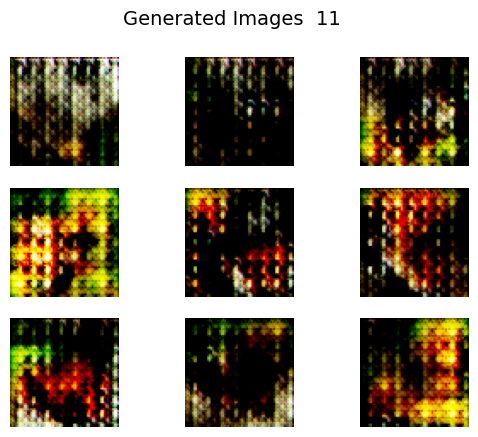

100%|██████████| 393/393 [00:13<00:00, 28.19it/s]


Epoch 13/20 - Discriminator Loss: 0.4444, Generator Loss: 1.7069


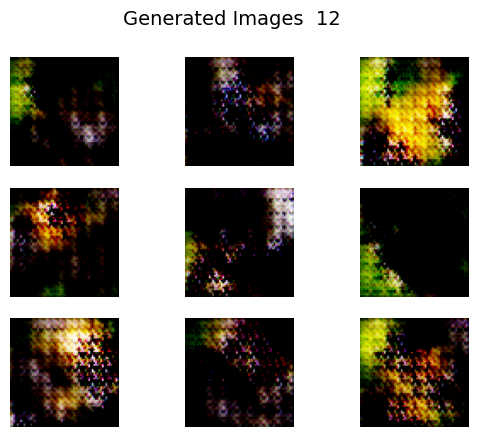

100%|██████████| 393/393 [00:13<00:00, 28.14it/s]


Epoch 14/20 - Discriminator Loss: 0.3990, Generator Loss: 1.8998


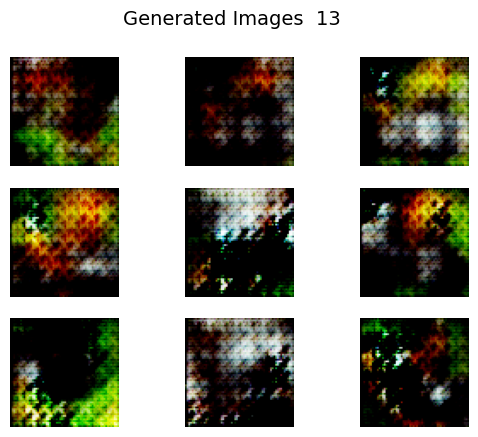

100%|██████████| 393/393 [00:13<00:00, 28.31it/s]


Epoch 15/20 - Discriminator Loss: 0.3870, Generator Loss: 1.9741


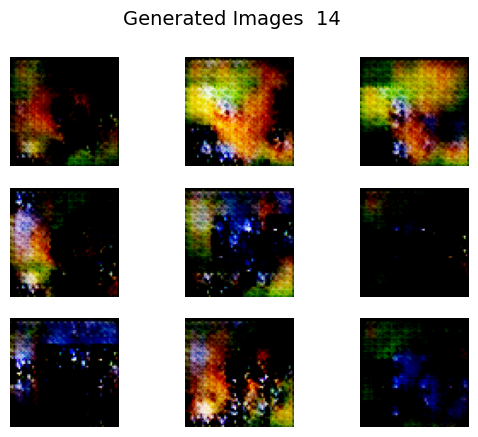

100%|██████████| 393/393 [00:13<00:00, 28.67it/s]


Epoch 16/20 - Discriminator Loss: 0.3968, Generator Loss: 1.9078


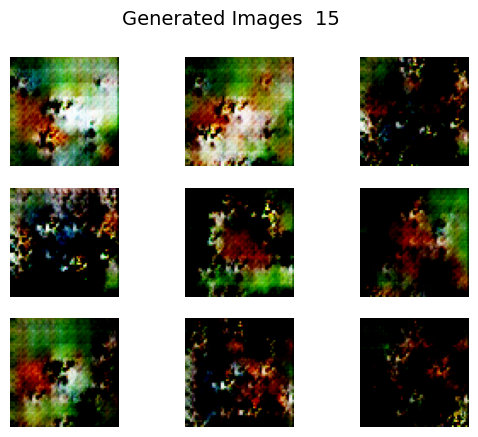

100%|██████████| 393/393 [00:13<00:00, 28.56it/s]


Epoch 17/20 - Discriminator Loss: 0.4134, Generator Loss: 1.7942


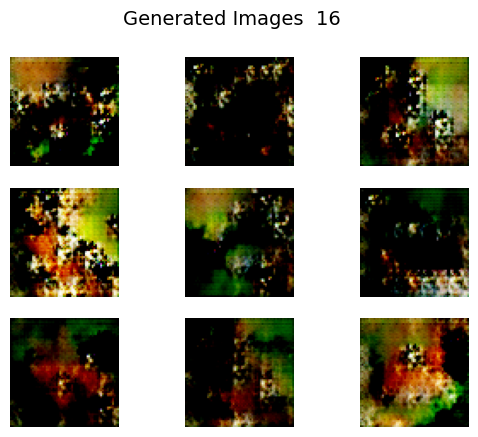

100%|██████████| 393/393 [00:13<00:00, 28.44it/s]


Epoch 18/20 - Discriminator Loss: 0.4175, Generator Loss: 1.7729


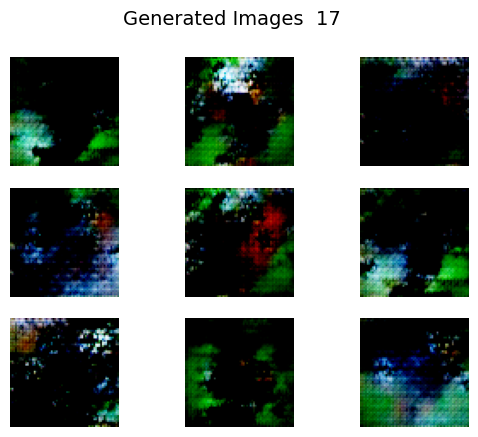

100%|██████████| 393/393 [00:13<00:00, 28.60it/s]


Epoch 19/20 - Discriminator Loss: 0.4070, Generator Loss: 1.8006


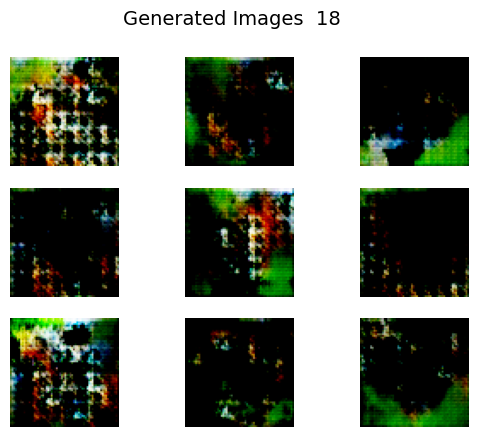

100%|██████████| 393/393 [00:13<00:00, 28.38it/s]


Epoch 20/20 - Discriminator Loss: 0.3886, Generator Loss: 1.8192


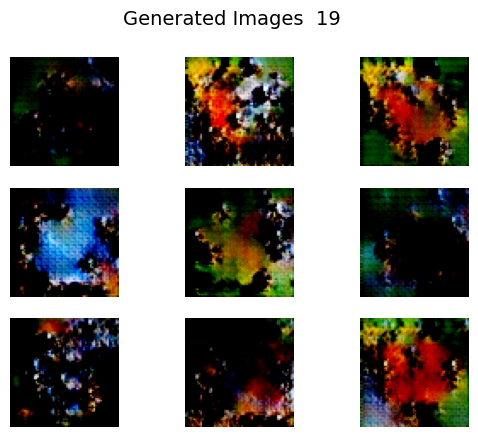

In [88]:
# Re-train the GAN model

latent_dim = 16
discriminator, generator, gan = build_gan(dataset.shape[1:], latent_dim, filters=64)
dataset_scaled = load_real_samples(data_path, scale=True)

train_gan(generator, discriminator, gan, dataset_scaled, latent_dim, n_epochs=20, batch_size=32)

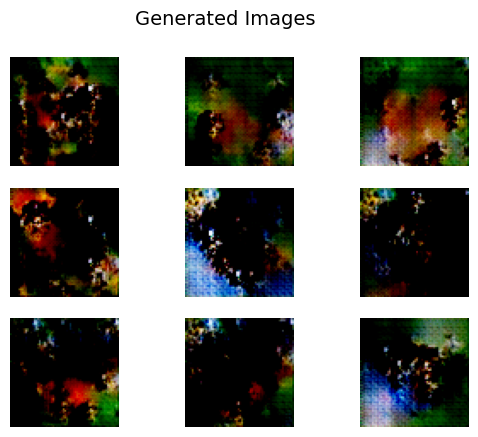

In [89]:
# Generate additional new images using the trained GAN model (to experiment with truncation)
truncated_noise = truncated_normal(mean=0, std=1, lower=-2, upper=2, size=9*latent_dim)
generated_images = generator(truncated_noise.reshape((9, latent_dim)), training=False)
grid_plot(generated_images.numpy(), name='Generated Images', n=3)

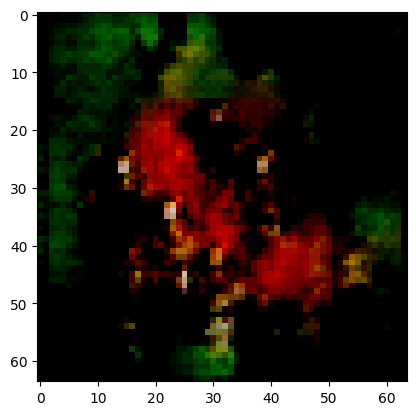

In [99]:
# Generate image1 for subsequent interpolation
truncated_noise1 = truncated_normal(mean=0, std=1, lower=-2, upper=2, size=1*latent_dim)
image1 = generator(truncated_noise1.reshape((1, latent_dim)), training=False)
plt.imshow(image1[0])

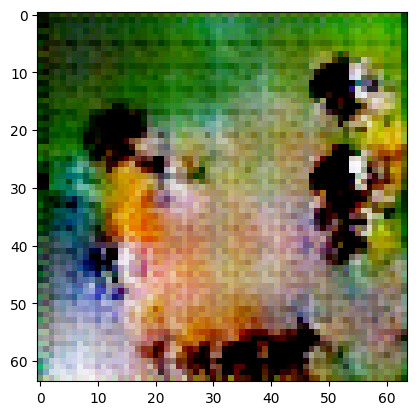

In [101]:
# Generate image2 for subsequent interpolation
truncated_noise2 = truncated_normal(mean=0, std=1, lower=-2, upper=2, size=1*latent_dim)
image2 = generator(truncated_noise2.reshape((1, latent_dim)), training=False)
plt.imshow(image2[0])

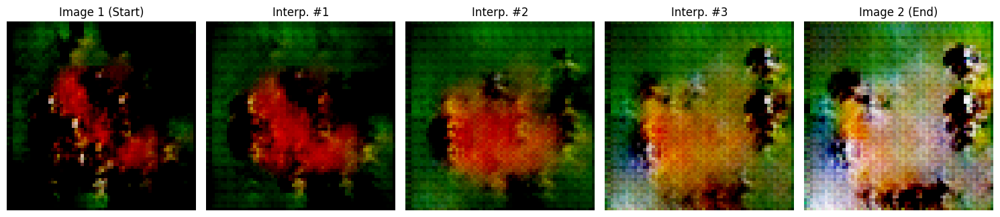

In [105]:
# Number of interpolated points
num_interpolations = 3

# Interpolation coefficients (evenly spaced between 0 and 1)
alphas = np.linspace(0, 1, num_interpolations + 2)  # Includes start and end

# Interpolate in latent space
interpolated_latent_vectors = np.array([truncated_noise1 * (1 - alpha) + truncated_noise2 * alpha for alpha in alphas]).round(3)

# Decode the interpolated latent vectors
interpolated_images = [generator(vector.reshape((1, latent_dim)), training=False) for vector in interpolated_latent_vectors]

# Plot the results
plt.figure(figsize=(15, 5))

# Plot the first image explicitly
plt.subplot(1, len(interpolated_images), 1)
plt.imshow(image1[0])
plt.title("Image 1 (Start)")
plt.axis("off")

# Plot the interpolated images
for i, image in enumerate(interpolated_images[1:-1], start=2):  # Skip first and last
    plt.subplot(1, len(interpolated_images), i)
    plt.imshow(image[0])
    plt.title(f"Interp. #{i-1}")
    plt.axis("off")

# Plot the last image explicitly
plt.subplot(1, len(interpolated_images), len(interpolated_images))
plt.imshow(image2[0])
plt.title("Image 2 (End)")
plt.axis("off")

plt.tight_layout()
plt.show()